# <p style="background-color:#FFFFFF; font-family:newtimeroman;color:#006400;font-size:63%;text-align:center;border-radius:10px 10px;">In the name of God </p>

# <p style="background-color:#FFFFFF; font-family:newtimeroman;color:#1569C7;font-size:120%;text-align:center;border-radius:10px 10px;">Credit Cart Customer Clustering 💳 </p>

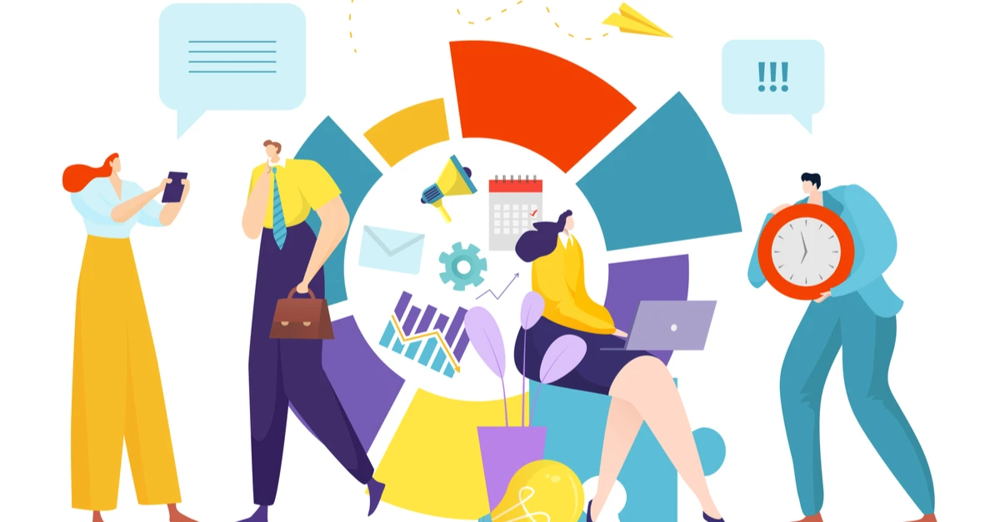

# <p style="background-color:#	#0C090A; font-family:newtimeroman;color:#1569C7;font-size:120%;text-align:center;border-radius:10px 10px;">About dataset </p>

### This case requires developing a customer segmentation to define a marketing strategy. The sample Dataset summarizes the usage behavior of 8950 active credit card holders during the last 6 months. The file is at a customer level with 18 behavioral variables.

Columns (Features):

* CUST_ID : Identification of Credit Card holder (Categorical)
* BALANCE : Balance amount left in their account to make purchases
* BALANCE_FREQUENCY : How frequently the Balance is updated, score between 0 and 1 (1 = frequently * * updated, 0 = not frequently updated)
* PURCHASES : Amount of purchases made from account
* ONEOFF_PURCHASES : Maximum purchase amount done in one-go
* INSTALLMENTS_PURCHASES : Amount of purchase done in installment
* CASH_ADVANCE : Cash in advance given by the user
* PURCHASES_FREQUENCY : How frequently the Purchases are being made, score between 0 and 1 (1 = * * * * frequently purchased, 0 = not frequently purchased)
* ONEOFF_PURCHASES_FREQUENCY : How frequently Purchases are happening in one-go (1 = frequently * purchased, 0 = not frequently purchased)
* PURCHASES_INSTALLMENTS_FREQUENCY : How frequently purchases in installments are being done (1 = * frequently done, 0 = not frequently done)
* CASH_ADVANCE_FREQUENCY : How frequently the cash in advance being paid
* CASH_ADVANCETRX : Number of Transactions made with "Cash in Advanced"
* PURCHASES_TRX : Numbe of purchase transactions made
* CREDIT_LIMIT : Limit of Credit Card for user
* PAYMENTS : Amount of Payment done by user
* MINIMUM_PAYMENTS : Minimum amount of payments made by user
* PRC_FULL_PAYMENT : Percent of full payment paid by user
* TENURE : Tenure of credit card service for user
* Target ==>>> We want to set Clusters

# <p style="background-color:#0C090A; font-family:newtimeroman;color:#736AFF;font-size:120%;text-align:center;border-radius:10px 10px;">Import Libraries and Dataset </p>

In [1]:
# import libraries

import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns

from kneed import KneeLocator
from sklearn . preprocessing import StandardScaler
# algoritm used 
from sklearn . cluster import KMeans
from sklearn . cluster import  MiniBatchKMeans
from sklearn.cluster import AffinityPropagation
from sklearn.cluster import DBSCAN
from sklearn . cluster import MeanShift 
from sklearn.cluster import AgglomerativeClustering 
from sklearn.mixture import GaussianMixture

from itertools import product
# metrics
from sklearn . metrics import silhouette_score
from sklearn.metrics import calinski_harabasz_score
from sklearn.metrics import davies_bouldin_score
from sklearn.metrics.pairwise import cosine_similarity   # measure the similarity
# warning
import warnings
warnings . simplefilter('ignore')
# pca & tsne
from sklearn.decomposition import PCA
from sklearn.manifold import TSNE


In [2]:
# import dataset

data = pd . read_csv (r'C:\Users\Alireza.norz\Downloads\Telegram Desktop\Customer_Data.csv')
df = pd . DataFrame(data)
df . head()

,CUST_ID,BALANCE,BALANCE_FREQUENCY,PURCHASES,ONEOFF_PURCHASES,INSTALLMENTS_PURCHASES,CASH_ADVANCE,PURCHASES_FREQUENCY,ONEOFF_PURCHASES_FREQUENCY,PURCHASES_INSTALLMENTS_FREQUENCY,CASH_ADVANCE_FREQUENCY,CASH_ADVANCE_TRX,PURCHASES_TRX,CREDIT_LIMIT,PAYMENTS,MINIMUM_PAYMENTS,PRC_FULL_PAYMENT,TENURE
0,C10001,40.900749,0.818182,95.40,0.00,95.4,0.000000,0.166667,0.000000,0.083333,0.000000,0,2,1000.0,201.802084,139.509787,0.000000,12
1,C10002,3202.467416,0.909091,0.00,0.00,0.0,6442.945483,0.000000,0.000000,0.000000,0.250000,4,0,7000.0,4103.032597,1072.340217,0.222222,12
2,C10003,2495.148862,1.000000,773.17,773.17,0.0,0.000000,1.000000,1.000000,0.000000,0.000000,0,12,7500.0,622.066742,627.284787,0.000000,12
3,C10004,1666.670542,0.636364,1499.00,1499.00,0.0,205.788017,0.083333,0.083333,0.000000,0.083333,1,1,7500.0,0.000000,NaN,0.000000,12
4,C10005,817.714335,1.000000,16.00,16.00,0.0,0.000000,0.083333,0.083333,0.000000,0.000000,0,1,1200.0,678.334763,244.791237,0.000000,12


# <p style="background-color:#0C090A; font-family:newtimeroman;color:#736AFF;font-size:120%;text-align:center;border-radius:10px 10px;">Overview of Dataset </p>

In [3]:
# describe numericaal columns
df . describe()

,BALANCE,BALANCE_FREQUENCY,PURCHASES,ONEOFF_PURCHASES,INSTALLMENTS_PURCHASES,CASH_ADVANCE,PURCHASES_FREQUENCY,ONEOFF_PURCHASES_FREQUENCY,PURCHASES_INSTALLMENTS_FREQUENCY,CASH_ADVANCE_FREQUENCY,CASH_ADVANCE_TRX,PURCHASES_TRX,CREDIT_LIMIT,PAYMENTS,MINIMUM_PAYMENTS,PRC_FULL_PAYMENT,TENURE
count,8950.000000,8950.000000,8950.000000,8950.000000,8950.000000,8950.000000,8950.000000,8950.000000,8950.000000,8950.000000,8950.000000,8950.000000,8949.000000,8950.000000,8637.000000,8950.000000,8950.000000
mean,1564.474828,0.877271,1003.204834,592.437371,411.067645,978.871112,0.490351,0.202458,0.364437,0.135144,3.248827,14.709832,4494.449450,1733.143852,864.206542,0.153715,11.517318
std,2081.531879,0.236904,2136.634782,1659.887917,904.338115,2097.163877,0.401371,0.298336,0.397448,0.200121,6.824647,24.857649,3638.815725,2895.063757,2372.446607,0.292499,1.338331
min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,50.000000,0.000000,0.019163,0.000000,6.000000
25%,128.281915,0.888889,39.635000,0.000000,0.000000,0.000000,0.083333,0.000000,0.000000,0.000000,0.000000,1.000000,1600.000000,383.276166,169.123707,0.000000,12.000000
50%,873.385231,1.000000,361.280000,38.000000,89.000000,0.000000,0.500000,0.083333,0.166667,0.000000,0.000000,7.000000,3000.000000,856.901546,312.343947,0.000000,12.000000
75%,2054.140036,1.000000,1110.130000,577.405000,468.637500,1113.821139,0.916667,0.300000,0.750000,0.222222,4.000000,17.000000,6500.000000,1901.134317,825.485459,0.142857,12.000000
max,19043.138560,1.000000,49039.570000,40761.250000,22500.000000,47137.211760,1.000000,1.000000,1.000000,1.500000,123.000000,358.000000,30000.000000,50721.483360,76406.207520,1.000000,12.000000


In [4]:
def check(df) :
    col = df . columns
    ov =[]
    for x in col :
        dtype = df[x] . dtype
        nu = df[x] . nunique()
        mv = df[x] . isnull() . sum()
        ov . append ([x,dtype , nu , mv])
    overview = pd . DataFrame (ov)
    overview . columns=['feature','dtype' , 'nunique' , 'missingvalue']
    return overview
check(df)    

,feature,dtype,nunique,missingvalue
0,CUST_ID,object,8950,0
1,BALANCE,float64,8871,0
2,BALANCE_FREQUENCY,float64,43,0
3,PURCHASES,float64,6203,0
4,ONEOFF_PURCHASES,float64,4014,0
5,INSTALLMENTS_PURCHASES,float64,4452,0
6,CASH_ADVANCE,float64,4323,0
7,PURCHASES_FREQUENCY,float64,47,0
8,ONEOFF_PURCHASES_FREQUENCY,float64,47,0
9,PURCHASES_INSTALLMENTS_FREQUENCY,float64,47,0


In [5]:
# we have 313 missing value in MINIMUM_PAYMENTS and 1 in CREDIT_LIMIT

# <p style="background-color:#0C090A; font-family:newtimeroman;color:#736AFF;font-size:120%;text-align:center;border-radius:10px 10px;">Data Cleaning </p>

In [6]:
df . isnull() . sum() . to_frame()

,0
CUST_ID,0
BALANCE,0
BALANCE_FREQUENCY,0
PURCHASES,0
ONEOFF_PURCHASES,0
INSTALLMENTS_PURCHASES,0
CASH_ADVANCE,0
PURCHASES_FREQUENCY,0
ONEOFF_PURCHASES_FREQUENCY,0
PURCHASES_INSTALLMENTS_FREQUENCY,0


In [7]:
# data with missing value
mv =  df[df . isna() . any(axis=1)]
mv

,CUST_ID,BALANCE,BALANCE_FREQUENCY,PURCHASES,ONEOFF_PURCHASES,INSTALLMENTS_PURCHASES,CASH_ADVANCE,PURCHASES_FREQUENCY,ONEOFF_PURCHASES_FREQUENCY,PURCHASES_INSTALLMENTS_FREQUENCY,CASH_ADVANCE_FREQUENCY,CASH_ADVANCE_TRX,PURCHASES_TRX,CREDIT_LIMIT,PAYMENTS,MINIMUM_PAYMENTS,PRC_FULL_PAYMENT,TENURE
3,C10004,1666.670542,0.636364,1499.00,1499.00,0.0,205.788017,0.083333,0.083333,0.000000,0.083333,1,1,7500.0,0.000000,NaN,0.0,12
45,C10047,2242.311686,1.000000,437.00,97.00,340.0,184.648692,0.333333,0.083333,0.333333,0.166667,2,5,2400.0,0.000000,NaN,0.0,12
47,C10049,3910.111237,1.000000,0.00,0.00,0.0,1980.873201,0.000000,0.000000,0.000000,0.500000,7,0,4200.0,0.000000,NaN,0.0,12
54,C10056,6.660517,0.636364,310.00,0.00,310.0,0.000000,0.666667,0.000000,0.666667,0.000000,0,8,1000.0,417.016763,NaN,0.0,12
55,C10057,1311.995984,1.000000,1283.90,1283.90,0.0,0.000000,0.250000,0.250000,0.000000,0.000000,0,6,6000.0,0.000000,NaN,0.0,12
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
8919,C19160,14.524779,0.333333,152.00,152.00,0.0,0.000000,0.333333,0.333333,0.000000,0.000000,0,2,1500.0,0.000000,NaN,0.0,6
8929,C19170,371.527312,0.333333,0.00,0.00,0.0,1465.407927,0.000000,0.000000,0.000000,0.166667,5,0,1500.0,0.000000,NaN,0.0,6
8935,C19176,183.817004,1.000000,465.90,0.00,465.9,0.000000,1.000000,0.000000,0.833333,0.000000,0,6,1500.0,0.000000,NaN,0.0,6
8944,C19185,193.571722,0.833333,1012.73,1012.73,0.0,0.000000,0.333333,0.333333,0.000000,0.000000,0,2,4000.0,0.000000,NaN,0.0,6


### we fill null vlues using median .

In [8]:
# fill _ MV
df['CREDIT_LIMIT'] . fillna (df['CREDIT_LIMIT'] . median() , inplace =True)
df['MINIMUM_PAYMENTS'].fillna(df['MINIMUM_PAYMENTS'].median(),inplace=True)

# Dropping the id column
df.drop('CUST_ID', axis=1, inplace=True)

In [9]:
df . isnull() . any() . sum()

# we fill missing value

0

# <p style="background-color:#0C090A; font-family:newtimeroman;color:#736AFF;font-size:120%;text-align:center;border-radius:10px 10px;">Visualization </p>

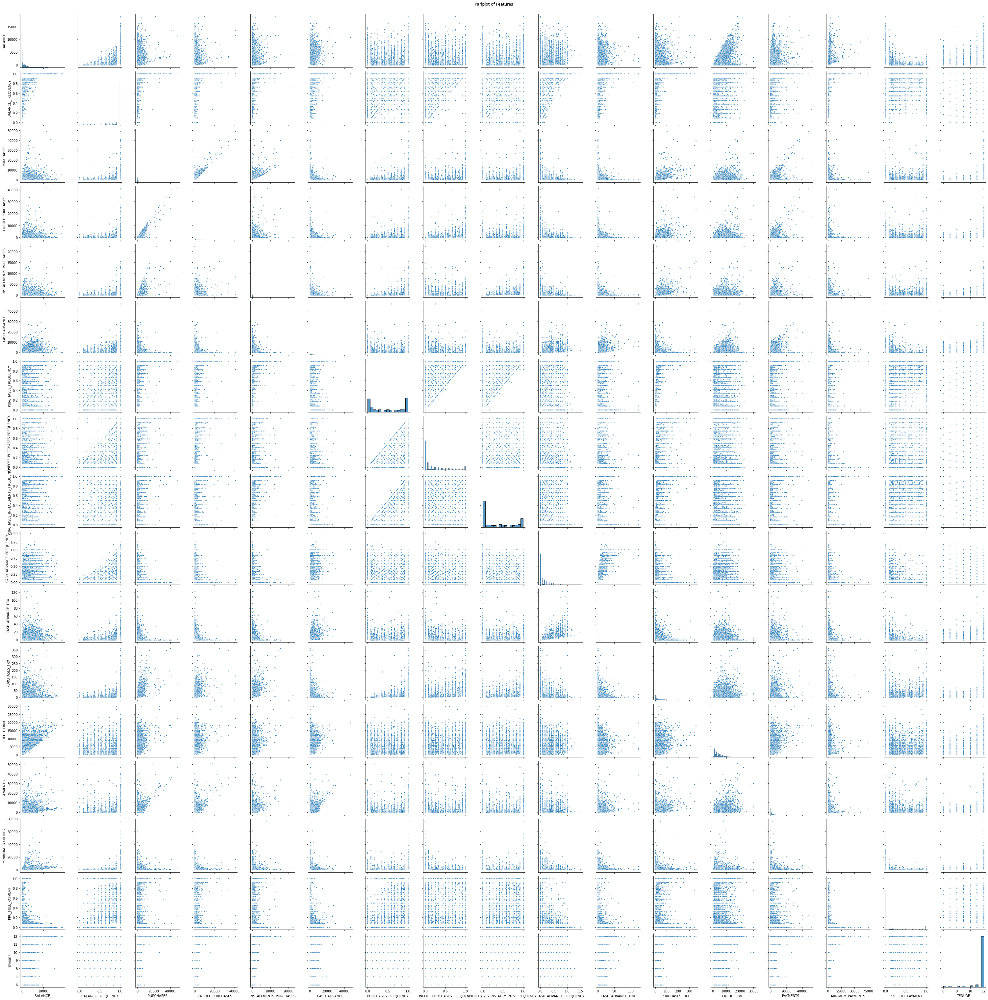

In [10]:
# Draw pair plot for EDA
pplot = sns.pairplot(df, markers='.')
pplot.fig.suptitle("Pariplot of Features", y=1)
plt.show()

* credit limit and balance  have linear relation
* Purchases, one-off purchases, and installment purchases are all related linearly.
* when PURCHASES_TRX is hight BALANCE_FREQUENCY have hight number
* when CASH_ADVANCE is hight  ONEOFF_PURCHASES have les number

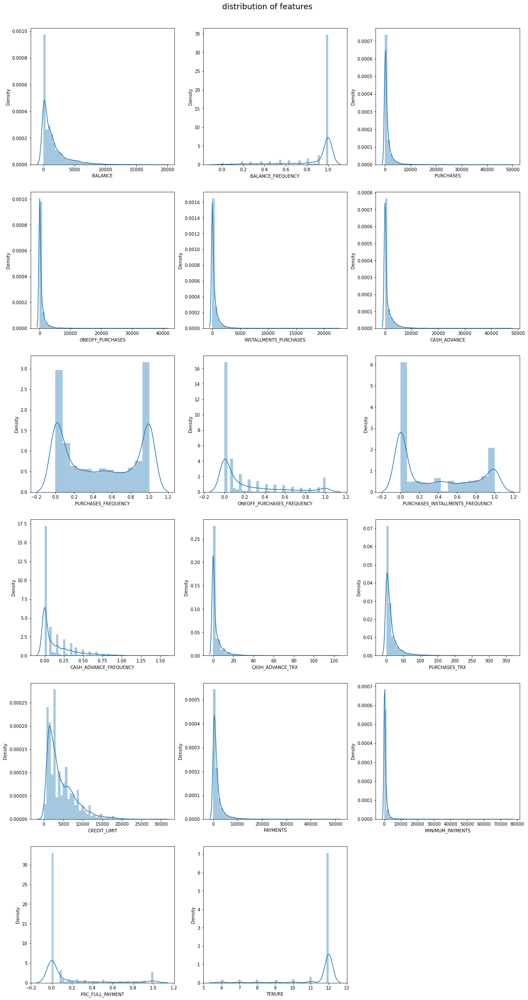

In [11]:
plt . figure (figsize =(20,40))
plt .suptitle ('distribution of features',y=0.9  , fontsize=18 )
for num in range(0,17):
    ax = plt.subplot(6,3,num+1)
    col = df.columns[num]
    sns.distplot(df[col], ax=ax)

* we can see there are a lot of zero values in every columns .
* and distributions are very left skewed .
* Those who have few purchases  ONEOFF_PURCHASES and INSTALLMENTS_PURCHASES is low .
* For this reason highest Distribution ONEOFF_PURCHASES and INSTALLMENTS_PURCHASES is 0

* ONEOFF_PURCHASES + INSTALLMENTS_PURCHASES = PURCHASES

*  discribuation in most of columns is unnormal .
* As the number of purchases increases, the number of "cash in advance" transactions decreases.
* Most people either don't purchase anything or purchase very frequently.
* As the credit balance is low, the "cash in advance" transactions are less.
* People who purchase in installments are more than people who purchase in one go.
* As the credit limit increase, the balance also increases hence a linear relationship.
* As the credit balance is low, the purchases, one-off purchases, and installment purchases are less.
* Purchases, one-off purchases, and installment purchases are all related linearly.

Text(0.5, 1.0, 'Heat Map')

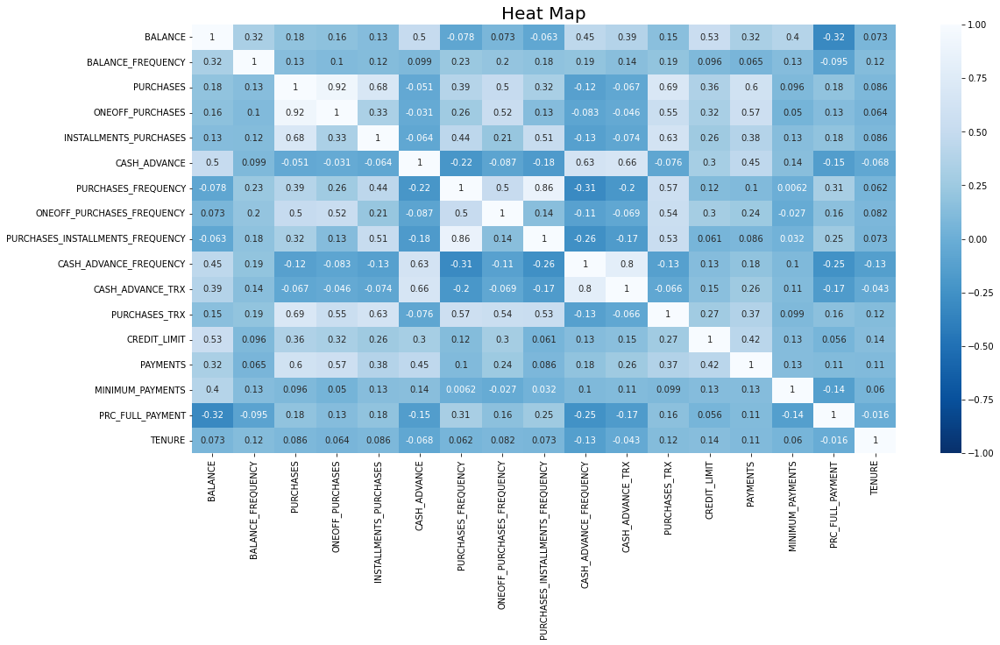

In [12]:
# corrolation

plt . figure (figsize =(18 , 9))
sns.heatmap(df.corr(), annot=True ,vmin=-1 , cmap='Blues_r')
plt.title('Heat Map', fontsize =20)

 * balance is more correlated with cash_advance and credit_limit
 * PURCHASES and  ONEOFF_PURCHASES have very high correlation  0.92
 
 * PURCHASES_FREQUENCY and PURCHASES_INSTALLMENTS_FREQUENCY correlation 0.86
 
 * CASH_ADVANCE_FREQUENCY and CASH_ADVANCE_TRX also have a high correlation (80%)
 
 * People do not make full payments when the balance is high.
 
 * when the purchase frequency is high, the number of times cash is paid in advance is less and vice-versa.
 * PRC_FULL_PAYMENT have low corrwith BALANCE
 * purchases of each customer have the highest correlation with oneoff_purchases, purchases_trx, installments_purchases and payments

# <p style="background-color:#0C090A; font-family:newtimeroman;color:#736AFF;font-size:120%;text-align:center;border-radius:10px 10px;">standardize the data </p>

Normalizing the data is important to ensure that the distance measure accords equal weight to each variable. Without normalization, the variable with the largest scale will dominate the measure. Also raw data might have some bias problems, when we normalize the data it is fixed.

In [13]:
scale =  StandardScaler()
scale_df = scale . fit_transform (df)
scale_df = pd . DataFrame (scale_df)
scale_df . columns = df . columns
scale_df

,BALANCE,BALANCE_FREQUENCY,PURCHASES,ONEOFF_PURCHASES,INSTALLMENTS_PURCHASES,CASH_ADVANCE,PURCHASES_FREQUENCY,ONEOFF_PURCHASES_FREQUENCY,PURCHASES_INSTALLMENTS_FREQUENCY,CASH_ADVANCE_FREQUENCY,CASH_ADVANCE_TRX,PURCHASES_TRX,CREDIT_LIMIT,PAYMENTS,MINIMUM_PAYMENTS,PRC_FULL_PAYMENT,TENURE
0,-0.731989,-0.249434,-0.424900,-0.356934,-0.349079,-0.466786,-0.806490,-0.678661,-0.707313,-0.675349,-0.476070,-0.511333,-0.960378,-0.528979,-0.302400,-0.525551,0.360680
1,0.786961,0.134325,-0.469552,-0.356934,-0.454576,2.605605,-1.221758,-0.678661,-0.916995,0.573963,0.110074,-0.591796,0.688678,0.818642,0.097500,0.234227,0.360680
2,0.447135,0.518084,-0.107668,0.108889,-0.454576,-0.466786,1.269843,2.673451,-0.916995,-0.675349,-0.476070,-0.109020,0.826100,-0.383805,-0.093293,-0.525551,0.360680
3,0.049099,-1.016953,0.232058,0.546189,-0.454576,-0.368653,-1.014125,-0.399319,-0.916995,-0.258913,-0.329534,-0.551565,0.826100,-0.598688,-0.228307,-0.525551,0.360680
4,-0.358775,0.518084,-0.462063,-0.347294,-0.454576,-0.466786,-1.014125,-0.399319,-0.916995,-0.675349,-0.476070,-0.551565,-0.905410,-0.364368,-0.257266,-0.525551,0.360680
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
8945,-0.737950,0.518084,-0.333293,-0.356934,-0.132643,-0.466786,1.269843,-0.678661,1.179833,-0.675349,-0.476070,-0.350408,-0.960378,-0.486217,-0.341250,1.183951,-4.122768
8946,-0.742423,0.518084,-0.329136,-0.356934,-0.122823,-0.466786,1.269843,-0.678661,1.179833,-0.675349,-0.476070,-0.350408,-0.960378,-0.503396,-0.228307,-0.525551,-4.122768
8947,-0.740398,-0.185477,-0.401965,-0.356934,-0.294893,-0.466786,0.854576,-0.678661,0.760469,-0.675349,-0.476070,-0.390639,-0.960378,-0.570615,-0.326875,0.329200,-4.122768
8948,-0.745174,-0.185477,-0.469552,-0.356934,-0.454576,-0.449352,-1.221758,-0.678661,-0.916995,0.157527,-0.182998,-0.591796,-1.097800,-0.580536,-0.338305,0.329200,-4.122768


# <p style="background-color:#0C090A; font-family:newtimeroman;color:#736AFF;font-size:120%;text-align:center;border-radius:10px 10px;">Dimensionality Reduction </p>


in this dataset they have a high number of dimensions along which the data is distributed . Data visualization can then become challenging and is often nearly impossible to do manually. Therefore, it is key to understand how to visualize high-dimensional data sets. This can be achieved using techniques known as dimensionality reduction or reduce the number of features in a dataset .

There are many algorithms that can be used for dimensionality reduction but we use two popular algorithms PCA and T-SNE in this project.

### PCA

In [14]:
from sklearn . decomposition import PCA
pca = PCA (n_components=3)
pca_fit = pca . fit_transform (scale_df)

pca = pd .DataFrame (pca_fit , columns=['pca1' , 'pca2' ,'pca3']) 
pca

,pca1,pca2,pca3
0,-1.683650,-1.072244,0.475577
1,-1.134087,2.509144,0.602114
2,0.969396,-0.383575,0.091007
3,-0.888222,0.004645,1.499710
4,-1.600022,-0.683797,0.347853
...,...,...,...
8945,-0.362572,-2.013437,-0.975678
8946,-0.580810,-1.675664,-1.222413
8947,-0.928985,-1.808049,-0.458316
8948,-2.337845,-0.653611,0.982821


### TSNE

In [15]:
tsne = TSNE(n_components=2, 
            perplexity=50,  
            random_state=42,
            n_iter=300).fit_transform(scale_df)

tsne = pd.DataFrame(tsne, columns=['tsne1', 'tsne2'])
tsne

,tsne1,tsne2
0,-3.385058,3.488309
1,-3.478794,-6.627779
2,4.340885,-4.332523
3,-3.219624,4.963959
4,-3.370931,1.910290
...,...,...
8945,1.486896,6.804966
8946,0.111250,5.755942
8947,0.424199,6.094427
8948,-7.792253,3.019411



# <p style="background-color:#0C090A; font-family:newtimeroman;color:#736AFF;font-size:120%;text-align:center;border-radius:10px 10px;">KMeans</p>

kmeans groups similare data point toghether and discover underliying pattern.

this algorithm clusters data by trying to separate samples in n groups of equal variance, minimizing  inertia . This algorithm requires the number of clusters to be specified.

first samples will be selected randomly to center the clusters, and then performs iterative calculations to optimize the positions of the centroids

![Alt text](https://cdn-images-1.medium.com/max/1600/1%2AKrcZK0xYgTa4qFrVr0fO2w.gif)

In [16]:
# set hyperparametrs
km_set = {'init' : 'random' , 'n_init' : 10 , 'max_iter' : 300 , 'random_state' : 42}

In [17]:
# find inertia for k cluster
inertia = []
for k in range (1 , 11) :
    km =  KMeans(n_clusters=k , **km_set)
    km . fit (scale_df)
    inertia . append (km . inertia_)

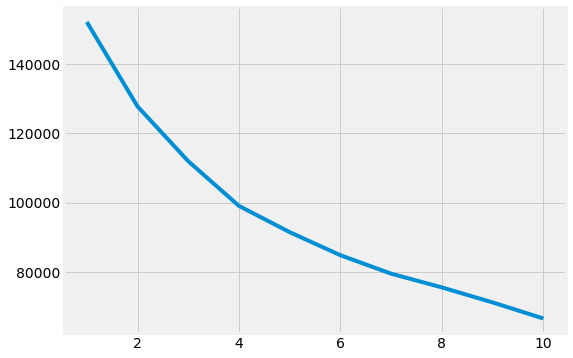

In [18]:
plt . figure (figsize=(9,6))
plt.style.use("fivethirtyeight")
plt . plot (range(1,11) , inertia)

## elbow method
Elbow method is a very popular method to select the optimal number of clusters by fitting the model with a range of values  .

In [19]:
# elbow method to find best nuber of clusters
ew = KneeLocator (range(1 , 11) , inertia , curve='convex' ,  direction = 'decreasing')
ew . elbow

4

Text(0.5, 1.0, 'elbow method for KMeans')

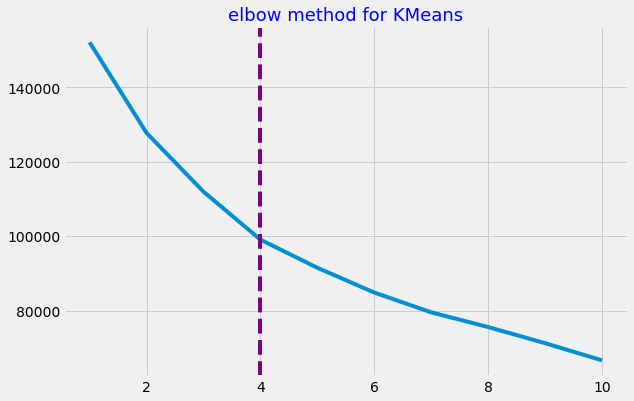

In [20]:
plt . figure (figsize=(9,6))
plt.style.use("fivethirtyeight")
plt . plot (range(1,11) , inertia)
plt . axvline (ew . elbow , ls ='--' , color = 'purple')
plt . title ('elbow method for KMeans' , fontsize=18 , color= 'blue')

# sil_score  --   &   --   ch_score

1-silhouette score is a metric used to calculate the goodness of a clustering technique. That is, it determines how well each object lies within its cluster. . Its value ranges from -1 to 1.


2-Calinski_Harabasz It is most commonly used to evaluate the goodness of split by a K-Means clustering algorithm for a given number of clusters ( * Vairinance raito criterion * )

* measure of how similar a object is to its own cluster (cohesion)

* compared to other cluster (sepraition)

In [21]:
# fid best number of clusters with creat for loop.
sil = []
chs  = []
for k in range (2,11) :
    km = KMeans (n_clusters= k , **km_set)
    km . fit (scale_df)
    sil . append (silhouette_score(scale_df , km . labels_))
    chs . append (calinski_harabasz_score (scale_df , km . labels_))


Text(0.5, 1.0, 'calinski_harabasz_score')

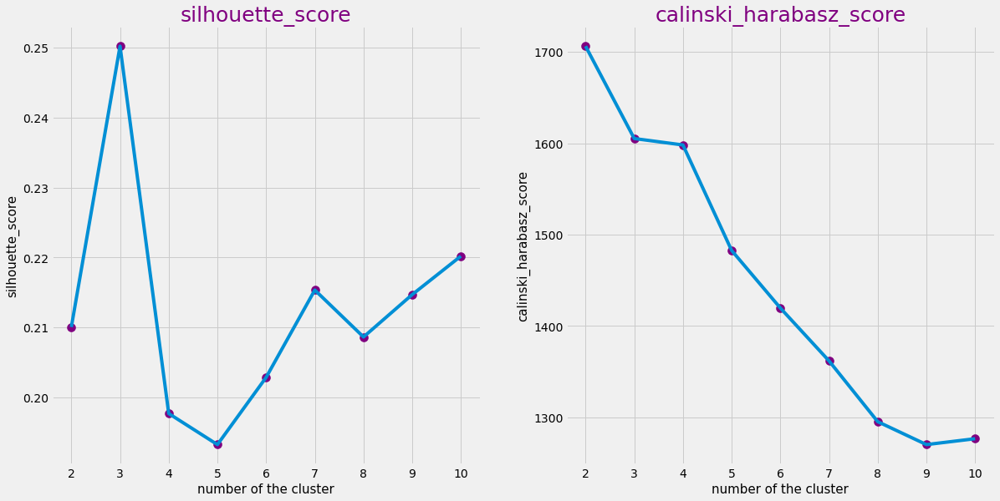

In [22]:
plt.style.use("fivethirtyeight")
plt . figure (figsize=(18,9))
plt . subplot (1 , 2 , 1)
plt . plot (range(2,11) , sil )
plt. scatter (range (2,11) , sil , marker ='o' ,s=100 , color='purple')
plt . xlabel('number of the cluster', fontsize = 15)
plt . ylabel('silhouette_score' , fontsize = 15)
plt . title ('silhouette_score' , fontsize=25 ,color='purple')
plt . subplot (1 , 2 , 2)
plt . plot (range(2,11) , chs )
plt. scatter (range (2,11) , chs , marker ='o' ,  s=100,  color='purple') 
plt . xlabel('number of the cluster' , fontsize = 15)
plt . ylabel('calinski_harabasz_score' , fontsize = 15)
plt . title ('calinski_harabasz_score' , fontsize=25 ,color='purple')

### SilhouetteVisualizer method

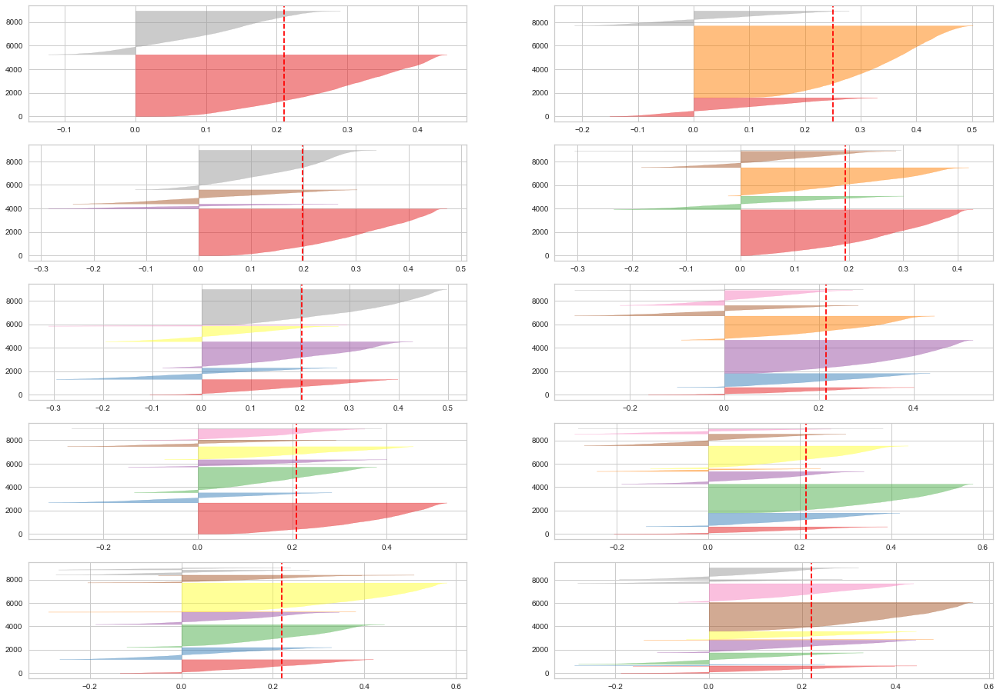

In [23]:
from yellowbrick.cluster import SilhouetteVisualizer
fig, ax = plt.subplots(5, 2, figsize=(20,15))
for k in range (2,12) :
    km = KMeans (n_clusters= k , **km_set)
    q, mod = divmod(k , 2)
    vis = SilhouetteVisualizer (km , ax=ax[q-1][mod])
    vis . fit (scale_df)

it seems that k=3 is the best number of clusters

In [24]:
km = KMeans (n_clusters=3 , random_state=42)
km . fit (scale_df)
label = km . labels_

In [25]:
# evaluation
silkm = silhouette_score (scale_df, km.labels_)
print('Silhouette Score : ', silkm)
chkm = calinski_harabasz_score (scale_df, km.labels_)
print('CH calinski_harabasz_score : ', chkm)
print('DB Score : ', davies_bouldin_score(scale_df, km.labels_))

Silhouette Score :  0.25061926305697263
CH calinski_harabasz_score :  1605.0854957869376
DB Score :  1.59684782274347


In [26]:
# centroid cluster in org dataset
centroid = km . cluster_centers_
centroid = pd . DataFrame (centroid , columns = df . columns)
# Scale back the data to the original representation.
cluster_centers = scale . inverse_transform(centroid)
cluster_centers = pd.DataFrame(data = cluster_centers, columns = [df.columns])
cluster_centers . T

,0,1,2
BALANCE,799.598455,3984.034534,2231.096018
BALANCE_FREQUENCY,0.835131,0.958377,0.981462
PURCHASES,505.893498,382.864652,4271.831475
ONEOFF_PURCHASES,253.270537,248.238834,2719.695762
INSTALLMENTS_PURCHASES,252.943653,134.703354,1552.621937
CASH_ADVANCE,330.717476,3866.638319,461.334415
PURCHASES_FREQUENCY,0.465246,0.231809,0.949052
ONEOFF_PURCHASES_FREQUENCY,0.132399,0.110908,0.668302
PURCHASES_INSTALLMENTS_FREQUENCY,0.345318,0.143706,0.744580
CASH_ADVANCE_FREQUENCY,0.068251,0.447360,0.063402


In [27]:
# add clusters to the orginal dataset
km_df = df . copy()
km_df ['clusters'] = label
km_df

,BALANCE,BALANCE_FREQUENCY,PURCHASES,ONEOFF_PURCHASES,INSTALLMENTS_PURCHASES,CASH_ADVANCE,PURCHASES_FREQUENCY,ONEOFF_PURCHASES_FREQUENCY,PURCHASES_INSTALLMENTS_FREQUENCY,CASH_ADVANCE_FREQUENCY,CASH_ADVANCE_TRX,PURCHASES_TRX,CREDIT_LIMIT,PAYMENTS,MINIMUM_PAYMENTS,PRC_FULL_PAYMENT,TENURE,clusters
0,40.900749,0.818182,95.40,0.00,95.40,0.000000,0.166667,0.000000,0.083333,0.000000,0,2,1000.0,201.802084,139.509787,0.000000,12,0
1,3202.467416,0.909091,0.00,0.00,0.00,6442.945483,0.000000,0.000000,0.000000,0.250000,4,0,7000.0,4103.032597,1072.340217,0.222222,12,1
2,2495.148862,1.000000,773.17,773.17,0.00,0.000000,1.000000,1.000000,0.000000,0.000000,0,12,7500.0,622.066742,627.284787,0.000000,12,0
3,1666.670542,0.636364,1499.00,1499.00,0.00,205.788017,0.083333,0.083333,0.000000,0.083333,1,1,7500.0,0.000000,312.343947,0.000000,12,0
4,817.714335,1.000000,16.00,16.00,0.00,0.000000,0.083333,0.083333,0.000000,0.000000,0,1,1200.0,678.334763,244.791237,0.000000,12,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
8945,28.493517,1.000000,291.12,0.00,291.12,0.000000,1.000000,0.000000,0.833333,0.000000,0,6,1000.0,325.594462,48.886365,0.500000,6,0
8946,19.183215,1.000000,300.00,0.00,300.00,0.000000,1.000000,0.000000,0.833333,0.000000,0,6,1000.0,275.861322,312.343947,0.000000,6,0
8947,23.398673,0.833333,144.40,0.00,144.40,0.000000,0.833333,0.000000,0.666667,0.000000,0,5,1000.0,81.270775,82.418369,0.250000,6,0
8948,13.457564,0.833333,0.00,0.00,0.00,36.558778,0.000000,0.000000,0.000000,0.166667,2,0,500.0,52.549959,55.755628,0.250000,6,0


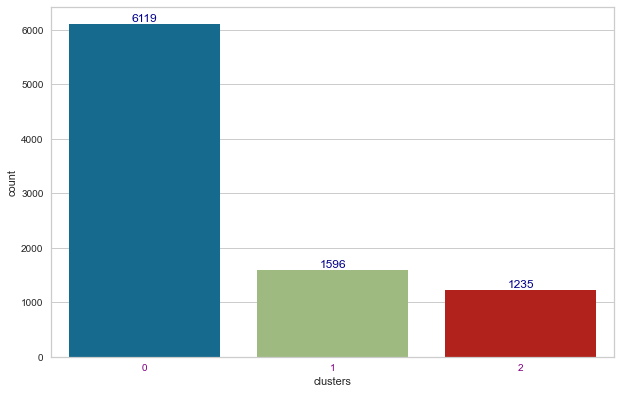

In [28]:
plt . figure (figsize=(9,6))
counttplot = sns . countplot (x='clusters' ,data = km_df )
plt . bar_label (counttplot. containers[0] , color='darkblue')
plt . xticks(color='purple')
plt . show()

<Figure size 1296x648 with 0 Axes>

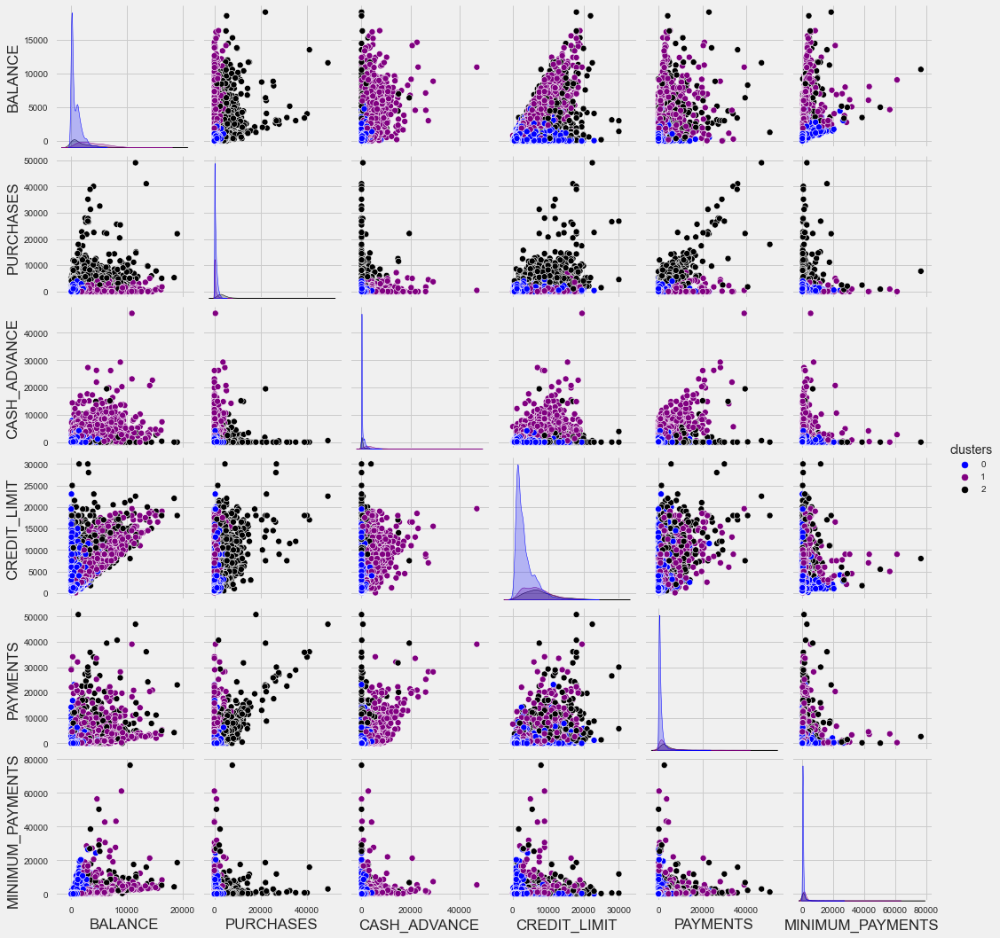

In [29]:
plt.style.use("fivethirtyeight")
plt . figure (figsize=(18,9))
palette= ['blue','purple','black']


col = ["BALANCE", "PURCHASES", "CASH_ADVANCE","CREDIT_LIMIT", "PAYMENTS", "MINIMUM_PAYMENTS","clusters"]
sns.pairplot( km_df[ col ], hue="clusters" , palette=palette)

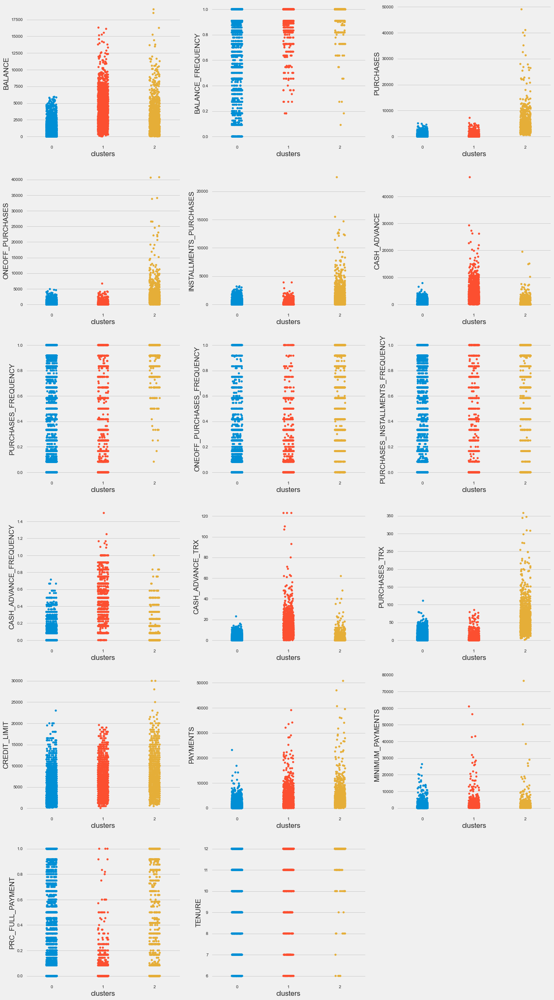

In [30]:
plt . figure (figsize =(20,40))
for num in range(0,17):
    ax = plt.subplot(6,3,num+1)
    col = df.columns[num]
    sns.stripplot(km_df['clusters'],km_df[col], ax=ax )

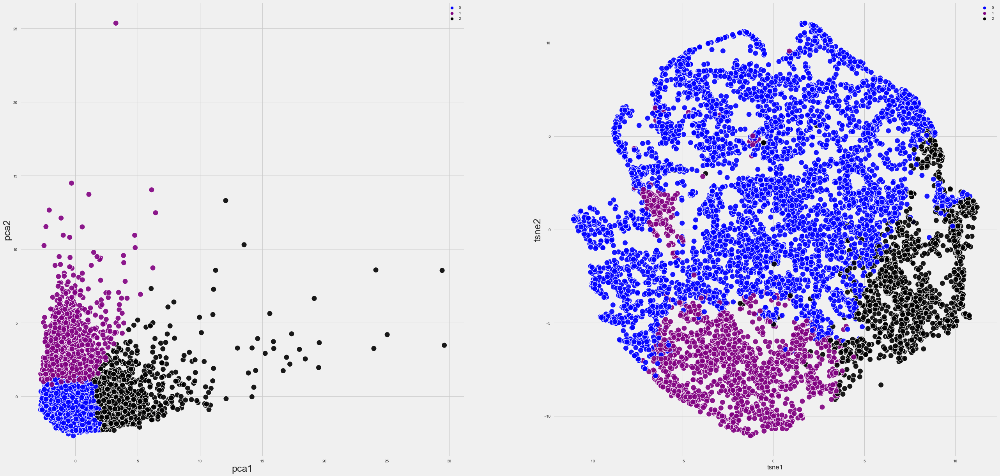

In [31]:
plt.figure(figsize = (40,20))
pallet= ['blue','purple','black']
plt. subplot (1,2,1)
sns . scatterplot (x='pca1' , y='pca2' ,hue= label , data= pca , palette= pallet, alpha=0.9 , s=200)
plt . xlabel('pca1' , fontsize=25)
plt . ylabel('pca2' , fontsize=25)
plt. subplot (1,2,2)
sns . scatterplot (x='tsne1' , y='tsne2' ,hue= label , data= tsne , palette= pallet, alpha=0.9 , s=200)
plt . ylabel('tsne1' , fontsize=25)
plt . ylabel('tsne2' ,fontsize=25)
plt . show()


* Cluster2: low average peaple

* Cluster1: They are strong in terms of purchase

* Cluster0: Medium people

# <p style="background-color:#0C090A; font-family:newtimeroman;color:#736AFF;font-size:120%;text-align:center;border-radius:10px 10px;">Mini Bach</p>

The Mini-batch K-means clustering algorithm is a version of the standard K-means algorithm in machine learning. It uses small, random, fixed-size batches of data to store in memory, and then with each iteration a random sample of the data is collected and used to update the clusters .

MiniBatchKMeans reduce the computation time and  converges faster than KMeans, but the quality of the results is reduced.

In [32]:
# creat loop for find umber of cluster
inertia = []
for k in range (1,11) :
    minibach = MiniBatchKMeans (n_clusters=k , random_state=1234)
    minibach . fit (scale_df)
    inertia . append(minibach . inertia_)
# elbow method
ew = KneeLocator(range(1,11) , inertia , curve='convex'  , direction='decreasing')
ew .elbow

4

In [33]:
# evaluation

sil =[]
chs =[]
for k in range(2,11):
    minibach = MiniBatchKMeans(n_clusters=k , random_state=1234 )
    minibach . fit (scale_df)
    sil . append (silhouette_score(scale_df , minibach . labels_))
    chs . append (calinski_harabasz_score (scale_df , minibach . labels_))


Text(0.5, 1.0, 'calinski_harabasz_score')

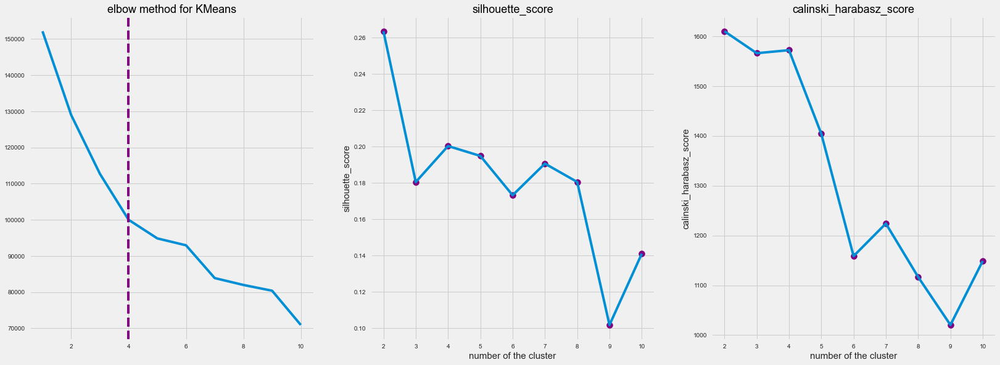

In [34]:
plt.style.use("fivethirtyeight")
plt . figure (figsize=(25,9))
plt . subplot (1 , 3 ,1)
plt . plot (range(1,11) , inertia)
plt . axvline (ew . elbow , ls ='--' , color = 'purple')
plt . title ('elbow method for KMeans' , fontsize=18 , color= 'black')
plt . subplot (1 , 3 ,2)
plt . plot (range(2,11) , sil )
plt. scatter (range (2,11) , sil , marker ='o' ,s=100 , color='purple')
plt . xlabel('number of the cluster', fontsize = 15)
plt . ylabel('silhouette_score' , fontsize = 15)
plt . title ('silhouette_score' , fontsize=18 , color= 'black')
plt . subplot (1 , 3 , 3)
plt . plot (range(2,11) , chs )
plt. scatter (range (2,11) , chs , marker ='o' ,  s=100,  color='purple') 
plt . xlabel('number of the cluster' , fontsize = 15)
plt . ylabel('calinski_harabasz_score' , fontsize = 15)
plt . title ('calinski_harabasz_score' , fontsize=18 , color= 'black')

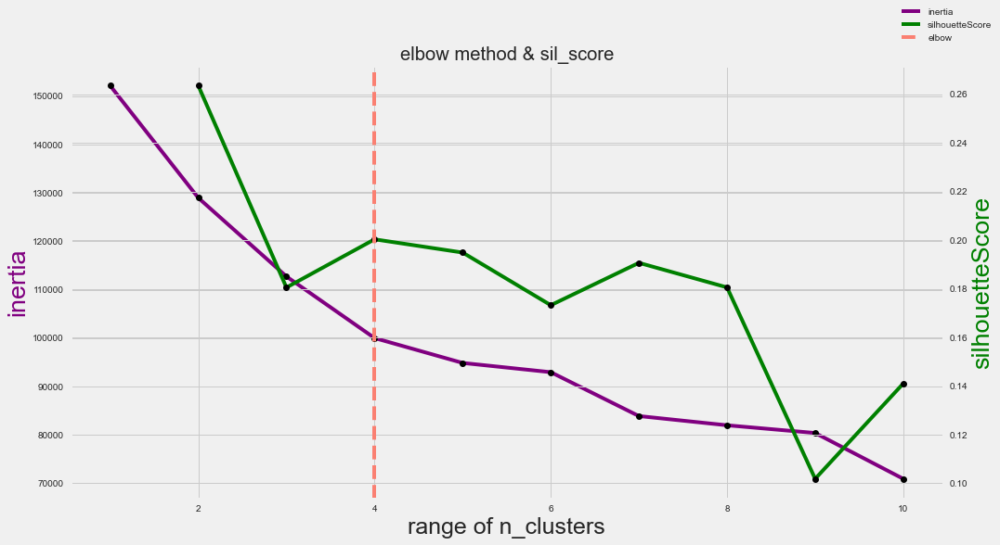

In [35]:
fig, ax1 = plt.subplots(figsize=(15 , 8))

ax1 .set_xlabel ('range of n_clusters' , fontsize=25)

ax1 .  plot (range(1 , 11) , inertia , color= 'purple', label='inertia')
ax1 . plot (range(1 , 11) , inertia , 'o' , color ='black')
ax1.set_ylabel('inertia', color = 'purple' , fontsize=27)

ax2 = ax1.twinx()
ax2 . plot  (range(2 , 11) ,sil  ,  color= 'green', label='silhouetteScore')
ax2 . plot  (range(2 , 11) ,sil , 'o' , color ='black')

plt . axvline (x =ew . elbow ,color = 'salmon' , label = 'elbow' , ls = '--' )
ax2.set_ylabel('silhouetteScore' , color = 'green' , fontsize=27)
plt . title ('elbow method & sil_score')
fig . legend()

In [36]:
# modeling mini_bach with 4 clusters
mb = MiniBatchKMeans (n_clusters=4)
mb . fit (scale_df)
label = mb . labels_

In [37]:
# evaluation
silmb = silhouette_score (scale_df, mb.labels_)
print('Silhouette Score : ', silmb)
chmb = calinski_harabasz_score (scale_df, mb.labels_)
print('CH calinski_harabasz_score : ', chmb)
print('DB Score : ', davies_bouldin_score(scale_df, mb.labels_))

Silhouette Score :  0.2036289582766103
CH calinski_harabasz_score :  1535.178925970895
DB Score :  1.5751065169129508


In [38]:
mb_df = df . copy  ()
mb_df['clusters'] = label
mb_df

,BALANCE,BALANCE_FREQUENCY,PURCHASES,ONEOFF_PURCHASES,INSTALLMENTS_PURCHASES,CASH_ADVANCE,PURCHASES_FREQUENCY,ONEOFF_PURCHASES_FREQUENCY,PURCHASES_INSTALLMENTS_FREQUENCY,CASH_ADVANCE_FREQUENCY,CASH_ADVANCE_TRX,PURCHASES_TRX,CREDIT_LIMIT,PAYMENTS,MINIMUM_PAYMENTS,PRC_FULL_PAYMENT,TENURE,clusters
0,40.900749,0.818182,95.40,0.00,95.40,0.000000,0.166667,0.000000,0.083333,0.000000,0,2,1000.0,201.802084,139.509787,0.000000,12,1
1,3202.467416,0.909091,0.00,0.00,0.00,6442.945483,0.000000,0.000000,0.000000,0.250000,4,0,7000.0,4103.032597,1072.340217,0.222222,12,3
2,2495.148862,1.000000,773.17,773.17,0.00,0.000000,1.000000,1.000000,0.000000,0.000000,0,12,7500.0,622.066742,627.284787,0.000000,12,0
3,1666.670542,0.636364,1499.00,1499.00,0.00,205.788017,0.083333,0.083333,0.000000,0.083333,1,1,7500.0,0.000000,312.343947,0.000000,12,1
4,817.714335,1.000000,16.00,16.00,0.00,0.000000,0.083333,0.083333,0.000000,0.000000,0,1,1200.0,678.334763,244.791237,0.000000,12,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
8945,28.493517,1.000000,291.12,0.00,291.12,0.000000,1.000000,0.000000,0.833333,0.000000,0,6,1000.0,325.594462,48.886365,0.500000,6,0
8946,19.183215,1.000000,300.00,0.00,300.00,0.000000,1.000000,0.000000,0.833333,0.000000,0,6,1000.0,275.861322,312.343947,0.000000,6,1
8947,23.398673,0.833333,144.40,0.00,144.40,0.000000,0.833333,0.000000,0.666667,0.000000,0,5,1000.0,81.270775,82.418369,0.250000,6,1
8948,13.457564,0.833333,0.00,0.00,0.00,36.558778,0.000000,0.000000,0.000000,0.166667,2,0,500.0,52.549959,55.755628,0.250000,6,1


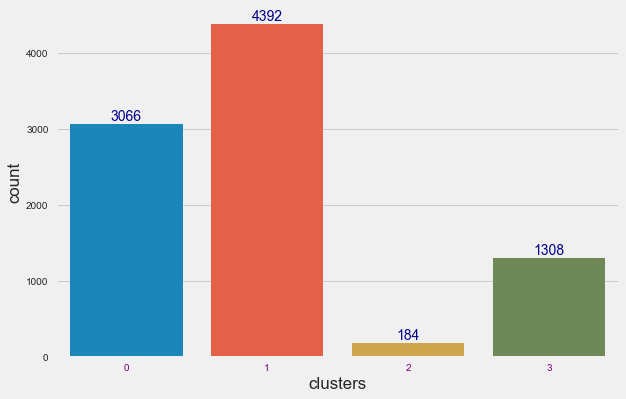

In [39]:
plt . figure (figsize=(9,6))
counttplot = sns . countplot (x='clusters' ,data = mb_df )
plt . bar_label (counttplot. containers[0] , color='darkblue')
plt . xticks(color='purple')
plt . show()

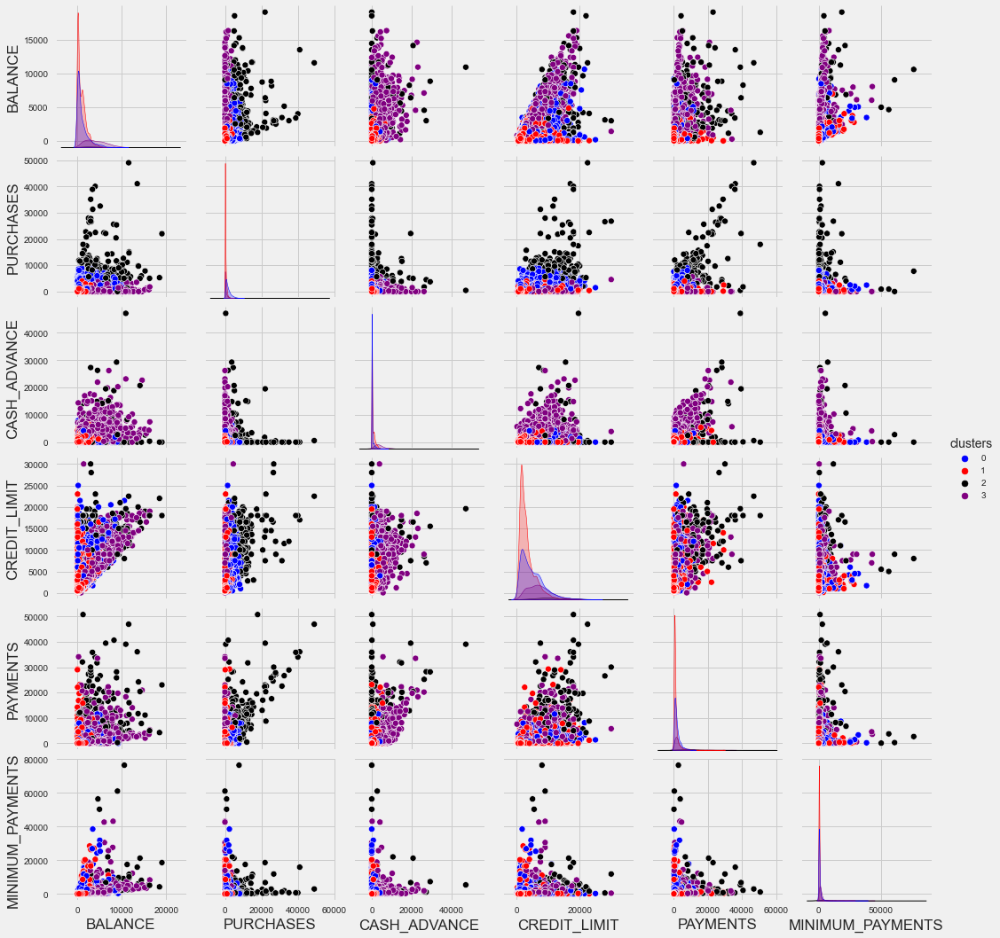

In [40]:
col = ["BALANCE", "PURCHASES", "CASH_ADVANCE","CREDIT_LIMIT", "PAYMENTS", "MINIMUM_PAYMENTS","clusters"]
palette= ['blue','red','black' , 'purple']
sns.pairplot( mb_df[ col ], hue="clusters" , palette=palette)

In [41]:
# groupby mini bach dataframe
describe_clusters = scale_df.groupby(mb_df['clusters']).mean()
describe_clusters

,BALANCE,BALANCE_FREQUENCY,PURCHASES,ONEOFF_PURCHASES,INSTALLMENTS_PURCHASES,CASH_ADVANCE,PURCHASES_FREQUENCY,ONEOFF_PURCHASES_FREQUENCY,PURCHASES_INSTALLMENTS_FREQUENCY,CASH_ADVANCE_FREQUENCY,CASH_ADVANCE_TRX,PURCHASES_TRX,CREDIT_LIMIT,PAYMENTS,MINIMUM_PAYMENTS,PRC_FULL_PAYMENT,TENURE
clusters,,,,,,,,,,,,,,,,,
0,-0.217487,0.378951,0.321316,0.190083,0.410374,-0.355612,1.078851,0.563280,0.945091,-0.463280,-0.356346,0.549613,0.087669,-0.005309,-0.065152,0.447438,0.155225
1,-0.312896,-0.394935,-0.327090,-0.231155,-0.348511,-0.230491,-0.619828,-0.376329,-0.549445,-0.190186,-0.218598,-0.433417,-0.356418,-0.281175,-0.121493,-0.204308,-0.078954
2,1.795468,0.426107,4.481310,3.801380,3.610108,0.767150,1.076449,1.609910,1.088951,0.148472,0.465264,3.644955,1.962590,3.595170,1.410286,0.353235,0.295702
3,1.307866,0.377896,-0.285271,-0.204141,-0.299546,1.499592,-0.599037,-0.283182,-0.523588,1.703664,1.503846,-0.345733,0.715197,0.450830,0.362277,-0.412478,-0.140338


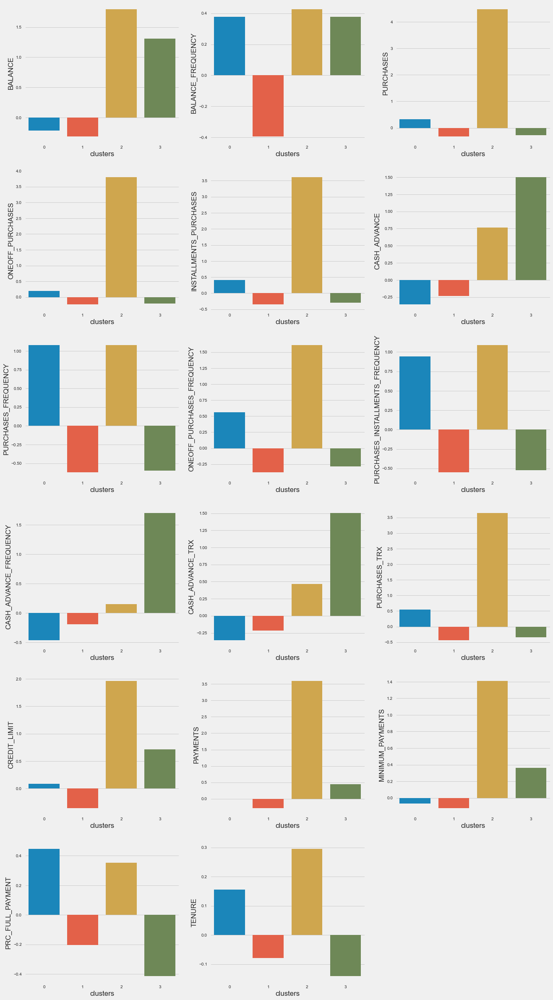

In [42]:
features = ['BALANCE', 'BALANCE_FREQUENCY', 'PURCHASES',
       'ONEOFF_PURCHASES', 'INSTALLMENTS_PURCHASES', 'CASH_ADVANCE',
       'PURCHASES_FREQUENCY', 'ONEOFF_PURCHASES_FREQUENCY',
       'PURCHASES_INSTALLMENTS_FREQUENCY', 'CASH_ADVANCE_FREQUENCY',
       'CASH_ADVANCE_TRX', 'PURCHASES_TRX', 'CREDIT_LIMIT', 'PAYMENTS',
       'MINIMUM_PAYMENTS', 'PRC_FULL_PAYMENT', 'TENURE']

plt . figure (figsize =(20,40))
for l , i in enumerate (features) :
    plt . subplot (6 , 3, l+1)
    sns.barplot(x = describe_clusters.index
            , y = i
            , data = describe_clusters )
plt.show()

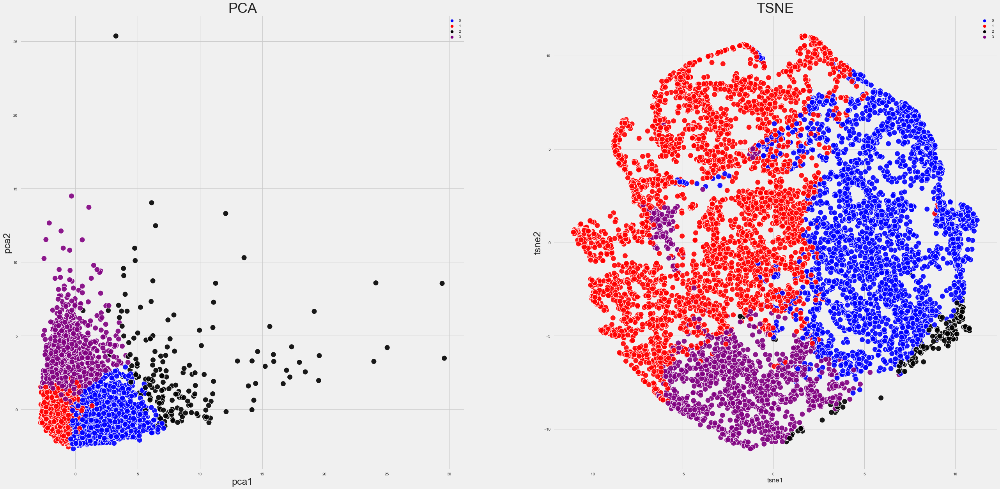

In [43]:

plt.figure(figsize = (40,20))
pallet= ['blue','purple','black' , 'red']
plt. subplot (1,2,1)
sns . scatterplot (x='pca1' , y='pca2' ,hue= label , data= pca , palette= palette, alpha=0.9 , s=200)
plt . xlabel('pca1' , fontsize=25)
plt . ylabel('pca2' , fontsize=25)
plt . title ('PCA', fontsize=36)
plt. subplot (1,2,2)
sns . scatterplot (x='tsne1' , y='tsne2' ,hue= label , data= tsne , palette= palette, alpha=0.9 , s=200)
plt . ylabel('tsne1' , fontsize=25)
plt . ylabel('tsne2' ,fontsize=25)
plt . title ('TSNE', fontsize=36)
plt . show()

### clusters 1,3 = high level costomer
### cluster 0 = medium level cotomer
### cluster 2 = low level costomer
-----------------------------------------------------------

# <p style="background-color:#0C090A; font-family:newtimeroman;color:#736AFF;font-size:120%;text-align:center;border-radius:10px 10px;">Mean Shift</p>

 It helps you find the dense areas of the data points. Mean-shift Clustering is a centroid-based algorithm with the objective of locating the center points of each group.  It is a centroid based algorithm, which works by updating candidates for centroids to be the mean of the points within a given region.

  it’s non-parametric and doesn’t require any predefined shape of the clusters in the feature space.

  It is one of the best algorithms to be used in image processing and computer vision. It works by providing weights to each data point.


   Mean shift is based on the idea of KDE , but what makes it different is that using the bandwidth parameter.
 
  * bandwidth, which dictates the size of the region to search through. 

  * This parameter can be set manually, but can be estimated using the provided estimate_bandwidth function, which is called if the bandwidth is not set.

The larger the local region is, the closer the local mean point is to the global one.
If we have a super small bandwidth, there will be a lot more non-sense clusters because we restricted the mean value calculation to a much smaller local area.



 

![Alt text](https://zjiayao.github.io/assets/img/ms/demo.gif)

In [44]:
# The following bandwidth can be automatically detected using
from sklearn.cluster import estimate_bandwidth
bandwidth = estimate_bandwidth(scale_df, n_samples=10 , n_jobs=-1)
bandwidth

3.6222018393485294

In [45]:
ms = MeanShift (bandwidth=bandwidth)
ms . fit (scale_df)
label = ms . labels_  

In [46]:
# number of cluster with 3.6 baandwidth
np . unique(label) . sum()

5778

In [47]:
# Find optimom bandwidth for implement mean shift by using silhouette and calinski 
silhouette_coef = []
for k in range(10,16,2):
    m_shift = MeanShift(bandwidth=k)
    m_shift.fit(scale_df)
    score = silhouette_score(scale_df, m_shift.labels_)
    silhouette_coef.append(score)

calinski_harabasz_coef = []
for k in range(10,16,2):
    m_shift = MeanShift(bandwidth=k)
    m_shift.fit(scale_df)
    score = calinski_harabasz_score(scale_df, m_shift.labels_)
    calinski_harabasz_coef.append(score)

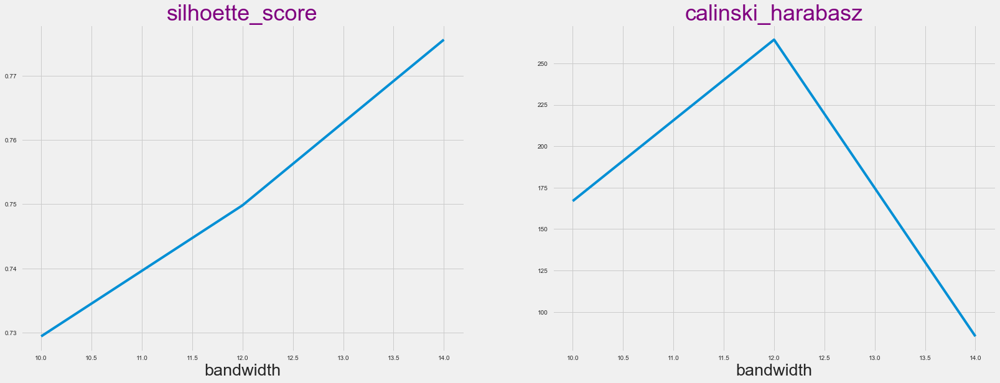

In [48]:
plt . figure (figsize=(25,9))
plt . subplot (1,2,1)
plt . plot (range (10,16,2),silhouette_coef)
plt . title ('silhoette_score' , fontsize=36 , color='purple')
plt . xlabel ('bandwidth' , fontsize=27)
plt . subplot (1,2,2)
plt . plot (range (10,16,2) , calinski_harabasz_coef) 
plt . title ('calinski_harabasz' , fontsize=36 , color='purple')
plt . xlabel ('bandwidth' , fontsize=27)
plt . show()

In [49]:
ms = MeanShift (bandwidth=12)
ms . fit (scale_df)
label = ms . labels_
print ('number of clusers' , np . unique (label))

number of clusers [0 1 2 3 4]


In [50]:
# evaluation
silms = silhouette_score (scale_df, ms.labels_)
print('Silhouette Score : ', silms)
chms = calinski_harabasz_score (scale_df, ms.labels_)
print('CH calinski_harabasz_score : ', chms)
print('DB Score : ', davies_bouldin_score(scale_df, ms.labels_))

Silhouette Score :  0.7498327500382691
CH calinski_harabasz_score :  264.2898390934374
DB Score :  0.7188175384118605


In [51]:
# Adding cluster column to dataframe
ms_df = df . copy()
ms_df['clusters'] = label
ms_df

,BALANCE,BALANCE_FREQUENCY,PURCHASES,ONEOFF_PURCHASES,INSTALLMENTS_PURCHASES,CASH_ADVANCE,PURCHASES_FREQUENCY,ONEOFF_PURCHASES_FREQUENCY,PURCHASES_INSTALLMENTS_FREQUENCY,CASH_ADVANCE_FREQUENCY,CASH_ADVANCE_TRX,PURCHASES_TRX,CREDIT_LIMIT,PAYMENTS,MINIMUM_PAYMENTS,PRC_FULL_PAYMENT,TENURE,clusters
0,40.900749,0.818182,95.40,0.00,95.40,0.000000,0.166667,0.000000,0.083333,0.000000,0,2,1000.0,201.802084,139.509787,0.000000,12,0
1,3202.467416,0.909091,0.00,0.00,0.00,6442.945483,0.000000,0.000000,0.000000,0.250000,4,0,7000.0,4103.032597,1072.340217,0.222222,12,0
2,2495.148862,1.000000,773.17,773.17,0.00,0.000000,1.000000,1.000000,0.000000,0.000000,0,12,7500.0,622.066742,627.284787,0.000000,12,0
3,1666.670542,0.636364,1499.00,1499.00,0.00,205.788017,0.083333,0.083333,0.000000,0.083333,1,1,7500.0,0.000000,312.343947,0.000000,12,0
4,817.714335,1.000000,16.00,16.00,0.00,0.000000,0.083333,0.083333,0.000000,0.000000,0,1,1200.0,678.334763,244.791237,0.000000,12,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
8945,28.493517,1.000000,291.12,0.00,291.12,0.000000,1.000000,0.000000,0.833333,0.000000,0,6,1000.0,325.594462,48.886365,0.500000,6,0
8946,19.183215,1.000000,300.00,0.00,300.00,0.000000,1.000000,0.000000,0.833333,0.000000,0,6,1000.0,275.861322,312.343947,0.000000,6,0
8947,23.398673,0.833333,144.40,0.00,144.40,0.000000,0.833333,0.000000,0.666667,0.000000,0,5,1000.0,81.270775,82.418369,0.250000,6,0
8948,13.457564,0.833333,0.00,0.00,0.00,36.558778,0.000000,0.000000,0.000000,0.166667,2,0,500.0,52.549959,55.755628,0.250000,6,0


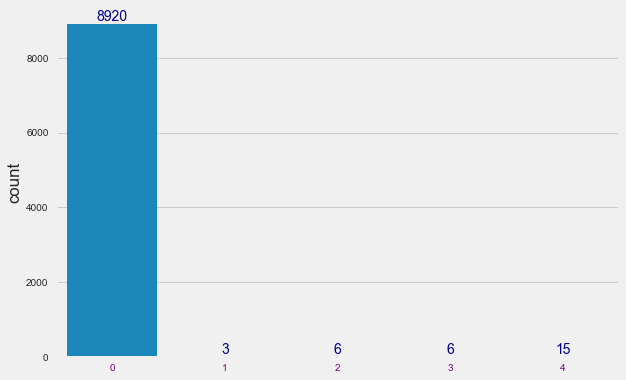

In [52]:
plt . figure (figsize=(9,6))
counttplot = sns . countplot (x=label )
plt . bar_label (counttplot. containers[0] , color='darkblue')
plt . xticks(color='purple') 
plt . show()

<AxesSubplot:xlabel='CASH_ADVANCE', ylabel='PURCHASES'>

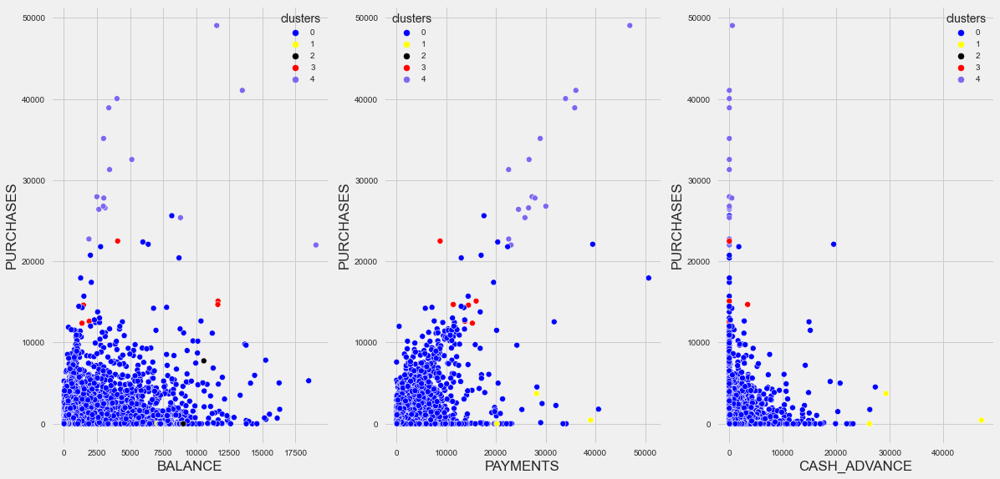

In [53]:
plt.figure(figsize = (18,9))
pallet= ['blue','yellow','black' , 'red' , 'mediumslateblue']
plt . subplot (1,3,1)
sns . scatterplot (x='BALANCE' , y='PURCHASES' , hue = 'clusters' , data = ms_df , palette=pallet)
plt . subplot (1,3,2)
sns . scatterplot (x='PAYMENTS' , y='PURCHASES' , hue = 'clusters' , data = ms_df , palette=pallet)
plt . subplot (1,3,3)
sns . scatterplot (x='CASH_ADVANCE' , y='PURCHASES' , hue = 'clusters' , data = ms_df , palette=pallet)

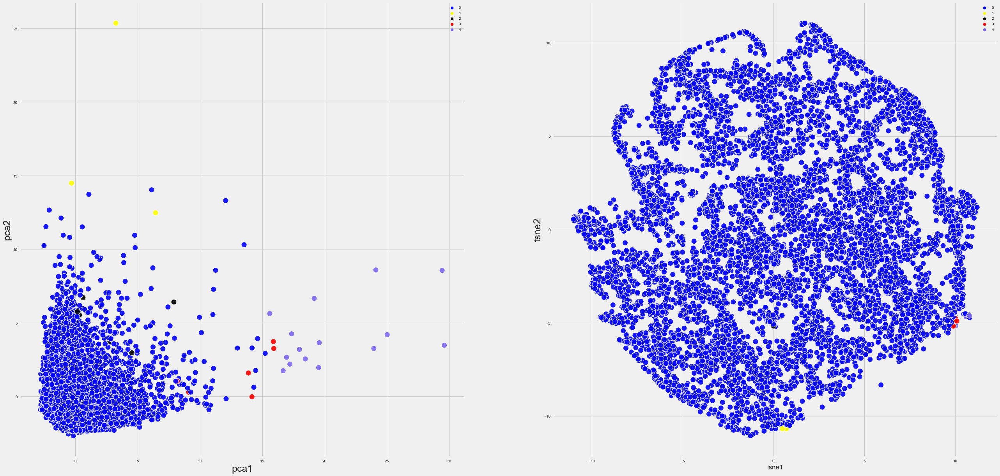

In [54]:
plt.figure(figsize = (40,20))
pallet= ['blue','yellow','black' , 'red' , 'mediumslateblue']
plt. subplot (1,2,1)
sns . scatterplot (x='pca1' , y='pca2' ,hue= label , data= pca , palette= pallet,  alpha=0.9 , s=200)
plt . xlabel('pca1' , fontsize=25)
plt . ylabel('pca2' , fontsize=25)
plt. subplot (1,2,2)
sns . scatterplot (x='tsne1' , y='tsne2' ,hue= label , data= tsne ,  alpha=0.9 , s=200, palette= pallet)
plt . ylabel('tsne1' , fontsize=25)
plt . ylabel('tsne2' ,fontsize=25)
plt . show()

meanshift aloritm not useful for this data . becuas most umber of data point clusters in group 1

# <p style="background-color:#0C090A; font-family:newtimeroman;color:#736AFF;font-size:120%;text-align:center;border-radius:10px 10px;">AffinityPropagation</p>

AffinityPropagation creates clusters by sending messages between pairs of samples until convergence. Unlike clustering algorithms such as k-means, in affinity propagation number of exemplars k need not be preassigned.

The main drawback of Affinity Propagation is its complexity. This makes Affinity Propagation most appropriate for small to medium sized datasets.

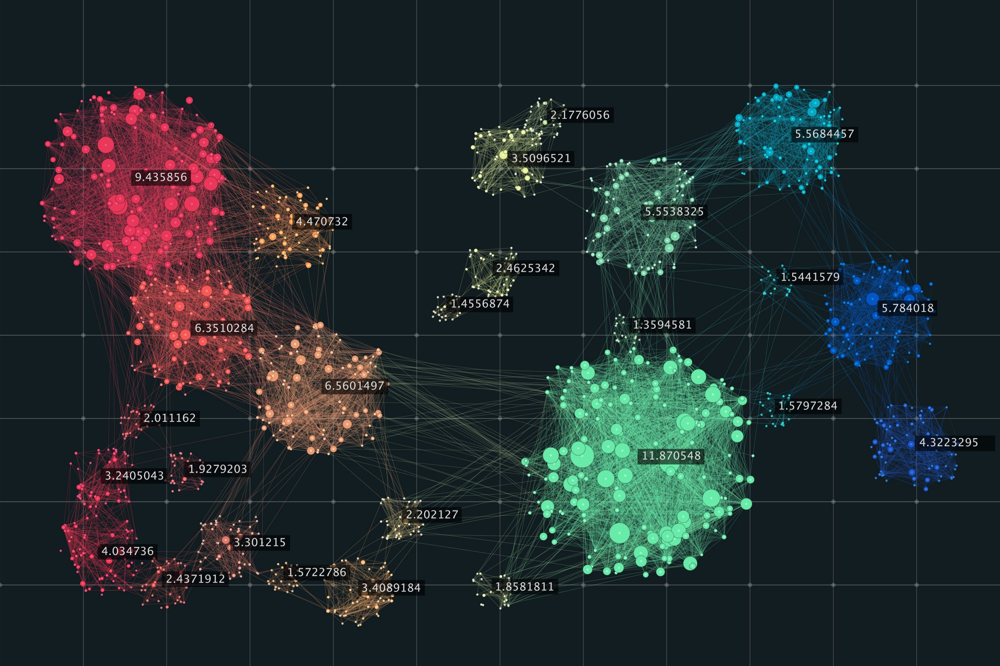](attachment:image.png)

In [55]:
# Compute Affinity Propagation
ap = AffinityPropagation(affinity = 'euclidean')
ap.fit(scale_df)

labels = ap.labels_  
np . unique (labels)

array([  0,   1,   2,   3,   4,   5,   6,   7,   8,   9,  10,  11,  12,
        13,  14,  15,  16,  17,  18,  19,  20,  21,  22,  23,  24,  25,
        26,  27,  28,  29,  30,  31,  32,  33,  34,  35,  36,  37,  38,
        39,  40,  41,  42,  43,  44,  45,  46,  47,  48,  49,  50,  51,
        52,  53,  54,  55,  56,  57,  58,  59,  60,  61,  62,  63,  64,
        65,  66,  67,  68,  69,  70,  71,  72,  73,  74,  75,  76,  77,
        78,  79,  80,  81,  82,  83,  84,  85,  86,  87,  88,  89,  90,
        91,  92,  93,  94,  95,  96,  97,  98,  99, 100, 101, 102, 103,
       104, 105, 106, 107, 108, 109, 110, 111, 112, 113, 114, 115, 116,
       117, 118, 119, 120, 121, 122, 123, 124, 125, 126, 127, 128, 129,
       130, 131, 132, 133, 134, 135, 136, 137, 138, 139, 140, 141, 142,
       143, 144, 145, 146, 147, 148, 149, 150, 151, 152, 153, 154, 155,
       156, 157, 158, 159, 160, 161, 162, 163, 164, 165, 166, 167, 168,
       169, 170, 171, 172, 173, 174, 175, 176, 177, 178, 179, 18

In [56]:
#number of clusters
A =np . unique (labels)
len(A)

370

 ### this algorithm is not useful for clustering the dataset

---------------------------------------------------------------------------------

# <p style="background-color:#0C090A; font-family:newtimeroman;color:#736AFF;font-size:120%;text-align:center;border-radius:10px 10px;">DBSCAN</p>
#### DBSCAN stands for Density-Based Spatial Clustering of Applications with Noise.
The DBSCAN groups together points with a dense neighborhood into clusters.


#### Finds core samples of high density and expands clusters from them . Good for data which contains clusters of similar density. 

##### K-Means is not capable of creating clusters of arbitary shape. This is were DBSCAN is helpful.


![Alt text](https://miro.medium.com/max/640/1%2AWBRWZwSeIw-V4Hw9-_0xrQ.gif)

DBSCAN algorithm requires two hypterparameters:

eps :
* Epsilon determine a specified radius that if includes enough number of points within, we call it dense area

minimumSamples :
* minimumSamples determine the minimum number of data points we want in a neighborhood to define a cluster.

In [57]:
# Using NearestNeighbors fucntion for to guess the right value for eps
from sklearn.neighbors import NearestNeighbors    # importing the library
neighb = NearestNeighbors(n_neighbors=4)          # creating an object of the NearestNeighbors class
nbrs=neighb.fit(scale_df)                         # fitting the data to the object
distances,indices = nbrs.kneighbors(scale_df)

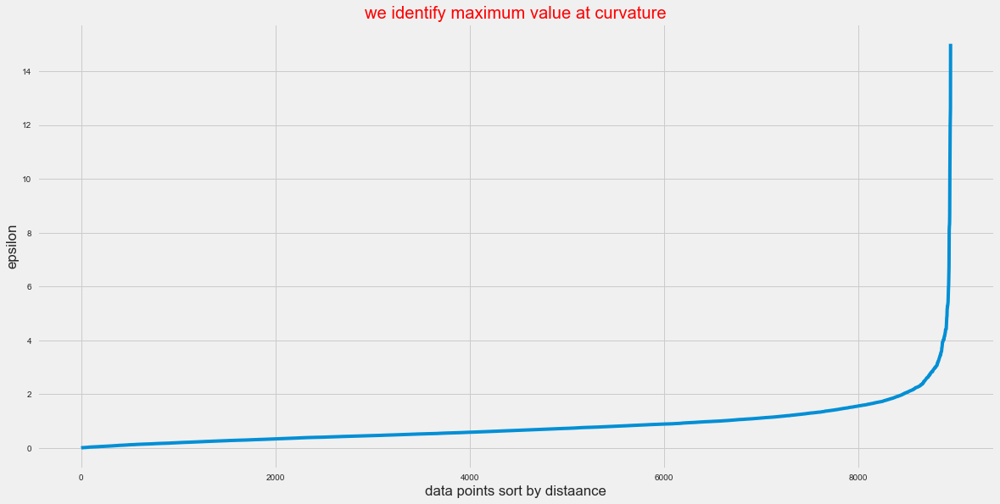

In [58]:
# Sort and plot the distances results
plt.style.use("fivethirtyeight")
distances = np.sort(distances, axis = 0)     # sorting the distances
distances = distances[:, 1]                  # taking the second column of the sorted distances
plt.rcParams['figure.figsize'] = (18,9)       # setting the figure size
plt.plot(distances)                          # plotting the distances
plt . title ('we identify maximum value at curvature' , color ='red')
plt . ylabel('epsilon')
plt . xlabel('data points sort by distaance')
plt.show()      

In [59]:
# creat loop for find best  nuber of  eps , min_smple
sil_score = []
for eps in np . arange(1 , 3 , 0.2) :
    for min_sample in range(1,10) :
        dbscan = DBSCAN (eps=eps , min_samples=min_sample)
        dbscan . fit (scale_df)
        sil_s = silhouette_score (scale_df , dbscan . labels_)
        sil_score . append ((eps , min_sample , sil_s , len(set(dbscan . labels_))))

In [60]:
dbscan_df = pd . DataFrame(sil_score , columns=('eps' ,'min_sample' , 'sil_score' , 'clusters'))
dbscan_df

,eps,min_sample,sil_score,clusters
0,1.0,1,-0.387867,2596
1,1.0,2,-0.458785,202
2,1.0,3,-0.419686,67
3,1.0,4,-0.319898,26
4,1.0,5,-0.248708,16
...,...,...,...,...
85,2.8,5,0.602494,2
86,2.8,6,0.599232,2
87,2.8,7,0.596768,2
88,2.8,8,0.595044,2


In [61]:
dbscan_df . sort_values('sil_score' , ascending=False) . head(10)

,eps,min_sample,sil_score,clusters
85,2.8,5,0.602494,2
86,2.8,6,0.599232,2
87,2.8,7,0.596768,2
88,2.8,8,0.595044,2
89,2.8,9,0.592850,2
76,2.6,5,0.576124,2
77,2.6,6,0.573902,2
78,2.6,7,0.571449,2
79,2.6,8,0.570027,2
80,2.6,9,0.566511,2


In [62]:
sil_score = []
for eps in np . arange(3 , 4 , 0.2) :
    for min_sample in range(1,10) :
        dbscan = DBSCAN (eps=eps , min_samples=min_sample)
        dbscan . fit (scale_df)
        sil_s = silhouette_score (scale_df , dbscan . labels_)
        sil_score . append ((eps , min_sample , sil_s , len(set(dbscan . labels_))))

In [63]:
dbscan_df = pd . DataFrame(sil_score , columns=('eps' ,'min_sample' , 'sil_score' , 'clusters'))
dbscan_df

,eps,min_sample,sil_score,clusters
0,3.0,1,0.111091,174
1,3.0,2,0.370740,15
2,3.0,3,0.396012,7
3,3.0,4,0.396916,5
4,3.0,5,0.625138,2
5,3.0,6,0.622812,2
6,3.0,7,0.620517,2
7,3.0,8,0.617363,2
8,3.0,9,0.613781,2
9,3.2,1,0.177677,138


In [64]:
dbscan_df . sort_values('sil_score' , ascending=False) . head(10)

,eps,min_sample,sil_score,clusters
39,3.8,4,0.697514,2
40,3.8,5,0.693243,2
41,3.8,6,0.689063,2
30,3.6,4,0.686881,2
42,3.8,7,0.685913,2
43,3.8,8,0.685473,2
44,3.8,9,0.683636,2
31,3.6,5,0.682358,2
32,3.6,6,0.679937,2
33,3.6,7,0.674841,2


In [65]:
# creat model with number of find it.
dbscan  = DBSCAN (eps=3.8 , min_samples=4)
dbscan . fit (scale_df)
label = dbscan . labels_
label

array([0, 0, 0, ..., 0, 0, 0], dtype=int64)

In [66]:
# evaluation
sildb = silhouette_score (scale_df, dbscan.labels_)
print('Silhouette Score : ', sildb)
chdb = calinski_harabasz_score (scale_df, dbscan.labels_)
print('CH calinski_harabasz_score : ', chdb)
print('DB Score : ', davies_bouldin_score(scale_df, dbscan.labels_))

Silhouette Score :  0.6975137959039236
CH calinski_harabasz_score :  733.2193776884613
DB Score :  1.5464350159533597


In [67]:
df_dbscan = df .copy()
df_dbscan['clusters'] = label
df_dbscan


,BALANCE,BALANCE_FREQUENCY,PURCHASES,ONEOFF_PURCHASES,INSTALLMENTS_PURCHASES,CASH_ADVANCE,PURCHASES_FREQUENCY,ONEOFF_PURCHASES_FREQUENCY,PURCHASES_INSTALLMENTS_FREQUENCY,CASH_ADVANCE_FREQUENCY,CASH_ADVANCE_TRX,PURCHASES_TRX,CREDIT_LIMIT,PAYMENTS,MINIMUM_PAYMENTS,PRC_FULL_PAYMENT,TENURE,clusters
0,40.900749,0.818182,95.40,0.00,95.40,0.000000,0.166667,0.000000,0.083333,0.000000,0,2,1000.0,201.802084,139.509787,0.000000,12,0
1,3202.467416,0.909091,0.00,0.00,0.00,6442.945483,0.000000,0.000000,0.000000,0.250000,4,0,7000.0,4103.032597,1072.340217,0.222222,12,0
2,2495.148862,1.000000,773.17,773.17,0.00,0.000000,1.000000,1.000000,0.000000,0.000000,0,12,7500.0,622.066742,627.284787,0.000000,12,0
3,1666.670542,0.636364,1499.00,1499.00,0.00,205.788017,0.083333,0.083333,0.000000,0.083333,1,1,7500.0,0.000000,312.343947,0.000000,12,0
4,817.714335,1.000000,16.00,16.00,0.00,0.000000,0.083333,0.083333,0.000000,0.000000,0,1,1200.0,678.334763,244.791237,0.000000,12,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
8945,28.493517,1.000000,291.12,0.00,291.12,0.000000,1.000000,0.000000,0.833333,0.000000,0,6,1000.0,325.594462,48.886365,0.500000,6,0
8946,19.183215,1.000000,300.00,0.00,300.00,0.000000,1.000000,0.000000,0.833333,0.000000,0,6,1000.0,275.861322,312.343947,0.000000,6,0
8947,23.398673,0.833333,144.40,0.00,144.40,0.000000,0.833333,0.000000,0.666667,0.000000,0,5,1000.0,81.270775,82.418369,0.250000,6,0
8948,13.457564,0.833333,0.00,0.00,0.00,36.558778,0.000000,0.000000,0.000000,0.166667,2,0,500.0,52.549959,55.755628,0.250000,6,0


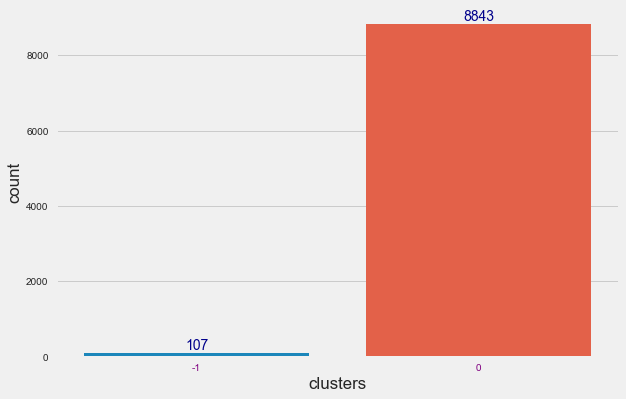

In [68]:
plt . figure (figsize=(9,6))
counttplot = sns . countplot (x='clusters' ,data = df_dbscan )
plt . bar_label (counttplot. containers[0] , color='darkblue')
plt . xticks(color='purple')
plt . show()

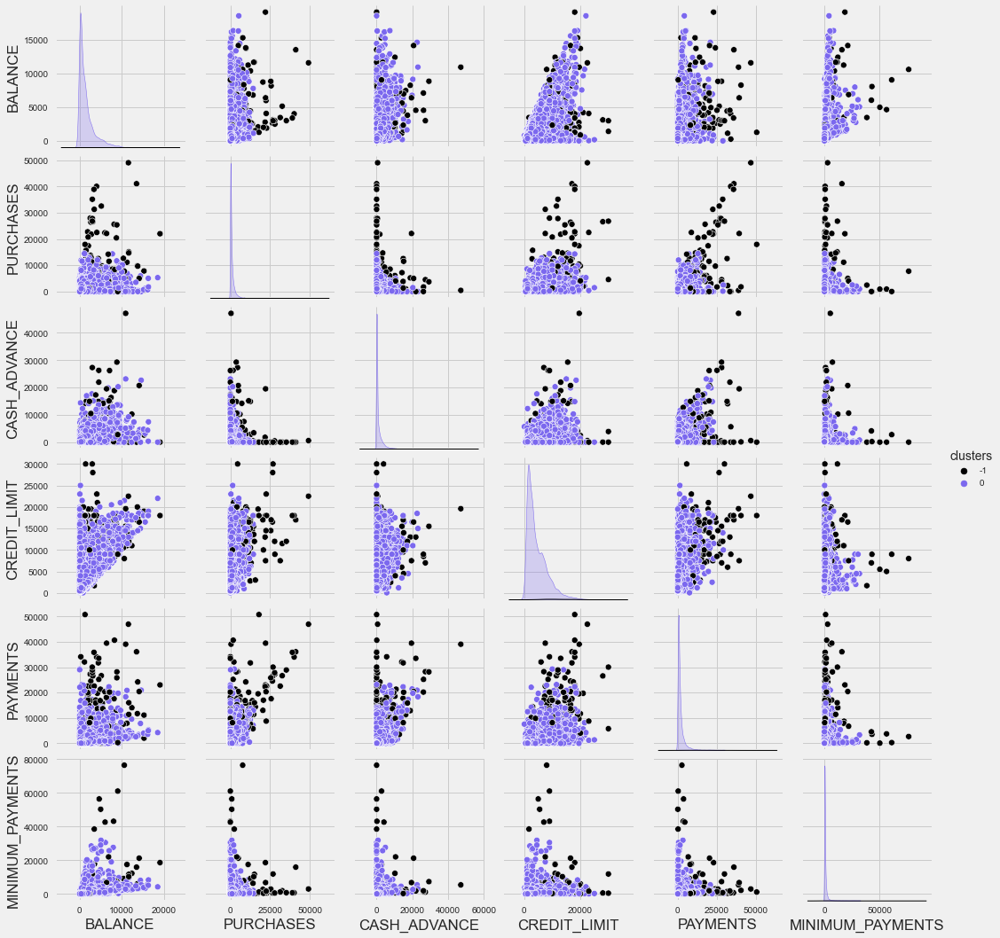

In [69]:
# pair plot
col = ["BALANCE", "PURCHASES", "CASH_ADVANCE","CREDIT_LIMIT", "PAYMENTS", "MINIMUM_PAYMENTS","clusters"]
palette= ['black', 'mediumslateblue']
sns.pairplot( df_dbscan[ col ], hue="clusters" , palette=palette)

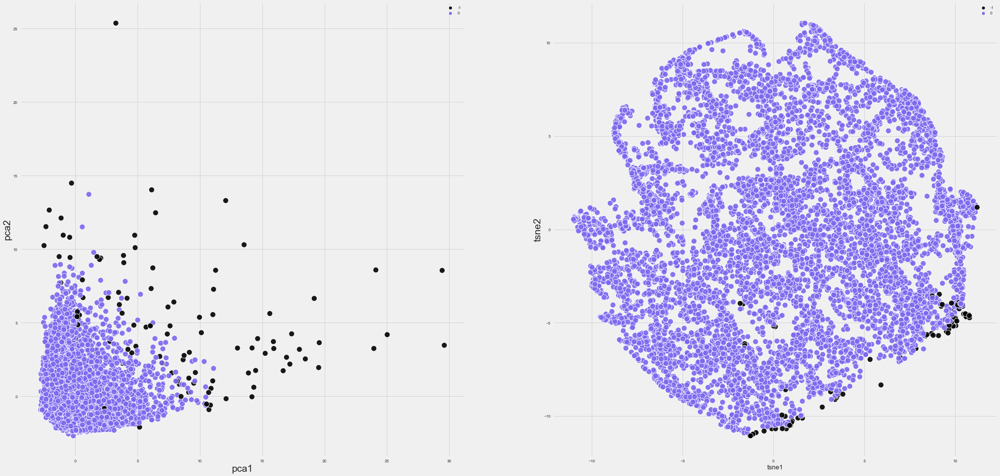

In [70]:
plt.figure(figsize = (40,20))
pallete= ['black', 'mediumslateblue']
plt. subplot (1,2,1)
sns . scatterplot (x='pca1' , y='pca2' ,hue= label , data= pca , palette= pallete,  alpha=0.9 , s=200)
plt . xlabel('pca1' , fontsize=25)
plt . ylabel('pca2' , fontsize=25)
plt. subplot (1,2,2)
sns . scatterplot (x='tsne1' , y='tsne2' ,hue= label , data= tsne ,  alpha=0.9 , s=200, palette= pallete)
plt . ylabel('tsne1' , fontsize=25)
plt . ylabel('tsne2' ,fontsize=25)
plt . show()

- cluster -1 : special costomer  (outliers)

- cluster 0 : normal people

# <p style="background-color:#0C090A; font-family:newtimeroman;color:#736AFF;font-size:120%;text-align:center;border-radius:10px 10px;">Gaussian Mixture Model</p>

A Gaussian mixture model (GMM) attempts to find a mixture of multi-dimensional Gaussian probability distributions that best model any input dataset

In [71]:
# creat loop for find best k
sil = []
chs = []
for i in range (2,11) :
    gmm = GaussianMixture (n_components=i , random_state=42)
    gmm .  fit (scale_df)
    sil . append (silhouette_score (scale_df , gmm . predict (scale_df)))
    chs . append (calinski_harabasz_score(scale_df , gmm . predict (scale_df)))

Text(0.5, 1.0, 'calinski_harabasz_score')

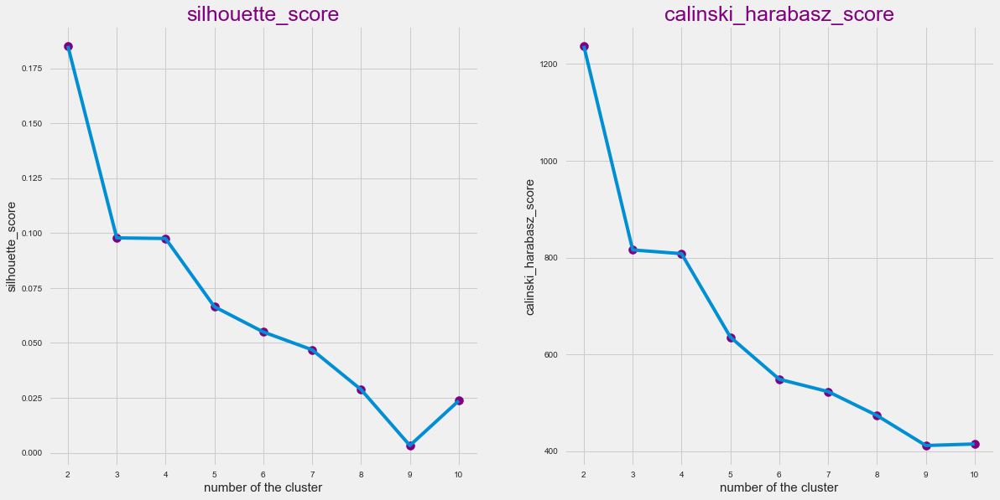

In [72]:
plt.style.use("fivethirtyeight")
plt . figure (figsize=(18,9))
plt . subplot (1 , 2 , 1)
plt . plot (range(2,11) , sil )
plt. scatter (range (2,11) , sil , marker ='o' ,s=100 , color='purple')
plt . xlabel('number of the cluster', fontsize = 15)
plt . ylabel('silhouette_score' , fontsize = 15)
plt . title ('silhouette_score' , fontsize=25 ,color='purple')
plt . subplot (1 , 2 , 2)
plt . plot (range(2,11) , chs )
plt. scatter (range (2,11) , chs , marker ='o' ,  s=100,  color='purple') 
plt . xlabel('number of the cluster' , fontsize = 15)
plt . ylabel('calinski_harabasz_score' , fontsize = 15)
plt . title ('calinski_harabasz_score' , fontsize=25 ,color='purple')

covariance_type :::

* "full": each component has its own general covariance matrix.
* "tied": all components share the same general covariance matrix.
* "diag": each component has its own diagonal covariance matrix.
* "spherical": each component has its own single variance.

In [73]:
# find best parametr for covariance_type

bic_score = []
types = []
for i in ["spherical", "tied", "diag", "full"]:
        gmm = GaussianMixture(n_components=2, random_state=42, covariance_type = i)
        gmm.fit(scale_df)
        bic_score.append(gmm.bic(scale_df))
        types.append(i)

gmm_type = pd . DataFrame ()
gmm_type['covariance_type'] = ["spherical", "tied", "diag", "full"]
gmm_type['bic_score'] = bic_score
gmm_type

,covariance_type,bic_score
0,spherical,378404.804056
1,tied,254572.478058
2,diag,319234.617259
3,full,138407.387592


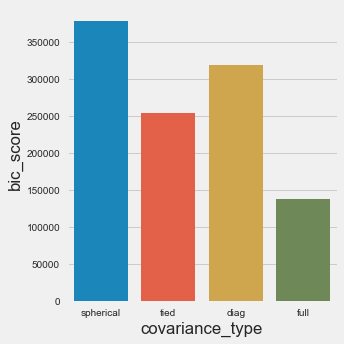

In [74]:
# Show results obtained from above for loop in plot
plt . figure (figsize=(9,6))
sns.catplot(
    data=gmm_type,
    kind="bar",
    x="covariance_type",
    y="bic_score" )
plt.show()

In [75]:
# Number of clusters = 2 , covariance_type = 'spherical'
gmm = GaussianMixture (n_components=2 , random_state=42 ,covariance_type='spherical')
gmm . fit (scale_df)
label = gmm . predict (scale_df)

In [76]:
# evaluation
silgm = silhouette_score (scale_df,gmm . predict (scale_df))
print('Silhouette Score : ', silgm)
chgm = calinski_harabasz_score (scale_df, gmm . predict (scale_df))
print('CH calinski_harabasz_score : ', chgm)
print('DB Score : ', davies_bouldin_score(scale_df,gmm . predict (scale_df)))
silgm = silgm 

Silhouette Score :  0.18520595997199957
CH calinski_harabasz_score :  1237.3821905040923
DB Score :  2.295047743584285


In [77]:
gmm_df = df . copy()
gmm_df['clusters'] = label
gmm_df

,BALANCE,BALANCE_FREQUENCY,PURCHASES,ONEOFF_PURCHASES,INSTALLMENTS_PURCHASES,CASH_ADVANCE,PURCHASES_FREQUENCY,ONEOFF_PURCHASES_FREQUENCY,PURCHASES_INSTALLMENTS_FREQUENCY,CASH_ADVANCE_FREQUENCY,CASH_ADVANCE_TRX,PURCHASES_TRX,CREDIT_LIMIT,PAYMENTS,MINIMUM_PAYMENTS,PRC_FULL_PAYMENT,TENURE,clusters
0,40.900749,0.818182,95.40,0.00,95.40,0.000000,0.166667,0.000000,0.083333,0.000000,0,2,1000.0,201.802084,139.509787,0.000000,12,1
1,3202.467416,0.909091,0.00,0.00,0.00,6442.945483,0.000000,0.000000,0.000000,0.250000,4,0,7000.0,4103.032597,1072.340217,0.222222,12,1
2,2495.148862,1.000000,773.17,773.17,0.00,0.000000,1.000000,1.000000,0.000000,0.000000,0,12,7500.0,622.066742,627.284787,0.000000,12,0
3,1666.670542,0.636364,1499.00,1499.00,0.00,205.788017,0.083333,0.083333,0.000000,0.083333,1,1,7500.0,0.000000,312.343947,0.000000,12,0
4,817.714335,1.000000,16.00,16.00,0.00,0.000000,0.083333,0.083333,0.000000,0.000000,0,1,1200.0,678.334763,244.791237,0.000000,12,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
8945,28.493517,1.000000,291.12,0.00,291.12,0.000000,1.000000,0.000000,0.833333,0.000000,0,6,1000.0,325.594462,48.886365,0.500000,6,1
8946,19.183215,1.000000,300.00,0.00,300.00,0.000000,1.000000,0.000000,0.833333,0.000000,0,6,1000.0,275.861322,312.343947,0.000000,6,1
8947,23.398673,0.833333,144.40,0.00,144.40,0.000000,0.833333,0.000000,0.666667,0.000000,0,5,1000.0,81.270775,82.418369,0.250000,6,1
8948,13.457564,0.833333,0.00,0.00,0.00,36.558778,0.000000,0.000000,0.000000,0.166667,2,0,500.0,52.549959,55.755628,0.250000,6,1


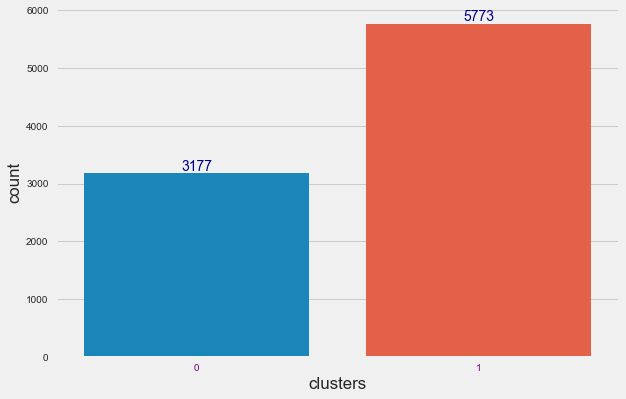

In [78]:
plt . figure (figsize=(9,6))
counttplot = sns . countplot (x='clusters' ,data = gmm_df )
plt . bar_label (counttplot. containers[0] , color='darkblue')
plt . xticks(color='purple')
plt . show()

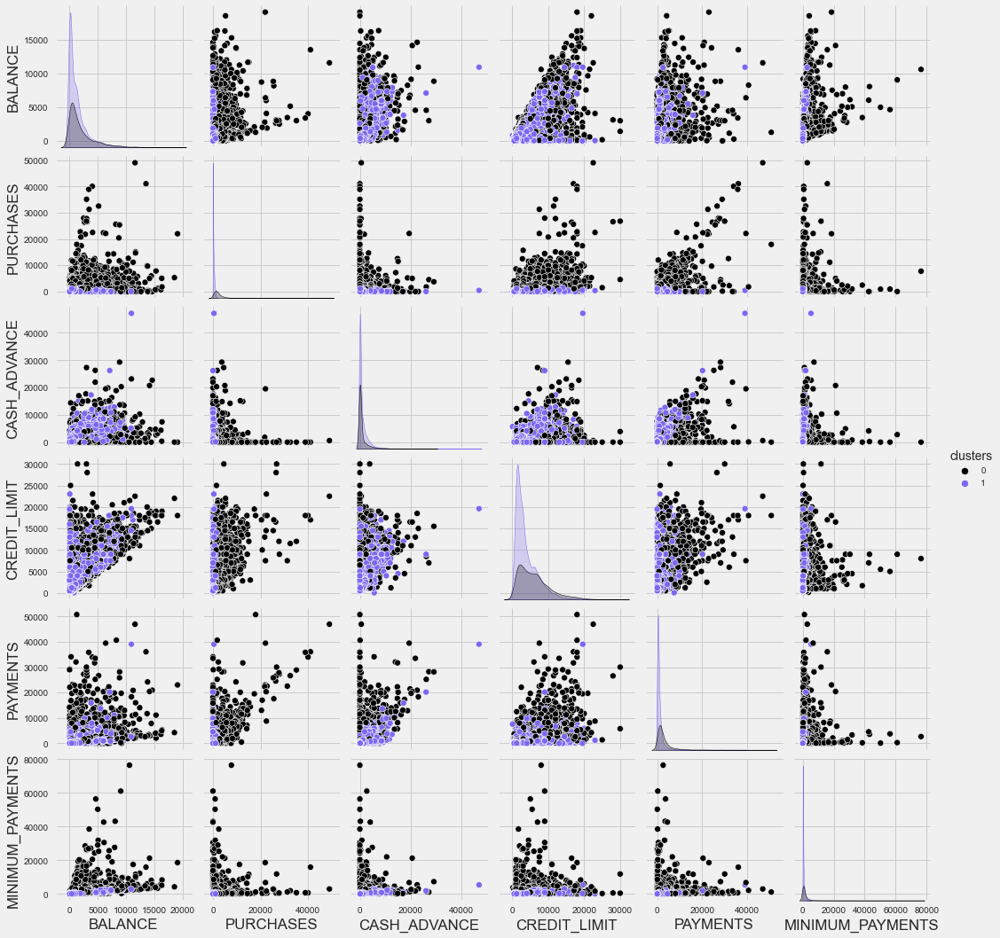

In [79]:
col = ["BALANCE", "PURCHASES", "CASH_ADVANCE","CREDIT_LIMIT", "PAYMENTS", "MINIMUM_PAYMENTS","clusters"]
palette= ['black', 'mediumslateblue']
sns.pairplot( gmm_df[ col ], hue="clusters" , palette=palette)

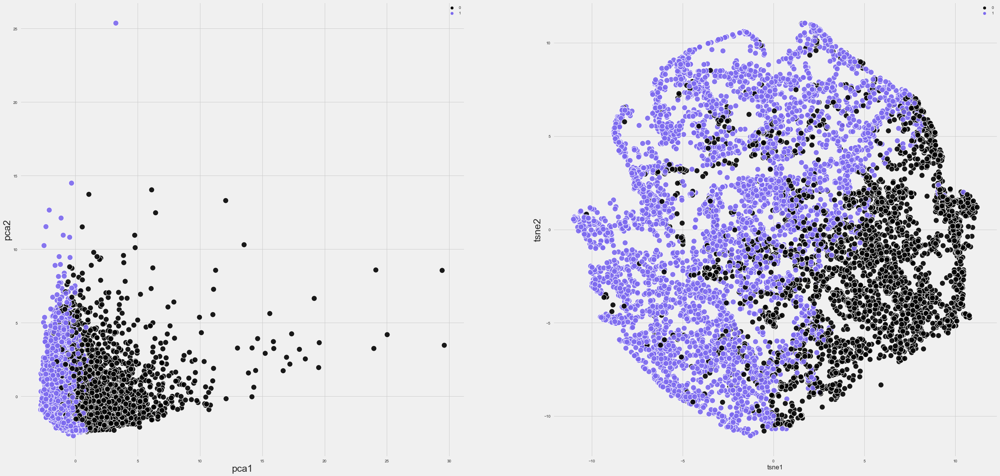

In [82]:
plt.figure(figsize = (40,20))
palette= ['black', 'mediumslateblue']
plt. subplot (1,2,1)
sns . scatterplot (x='pca1' , y='pca2' ,hue= label , data= pca , palette= palette,  alpha=0.9 , s=200)
plt . xlabel('pca1' , fontsize=25)
plt . ylabel('pca2' , fontsize=25)
plt. subplot (1,2,2)
sns . scatterplot (x='tsne1' , y='tsne2' ,hue= label , data= tsne ,  alpha=0.9 , s=200, palette= palette)
plt . ylabel('tsne1' , fontsize=25)
plt . ylabel('tsne2' ,fontsize=25)
plt . show()

# <p style="background-color:#0C090A; font-family:newtimeroman;color:#736AFF;font-size:120%;text-align:center;border-radius:10px 10px;">Hierarical (Agglomerative Clustering)</p>

 A Hierarchical clustering method works via grouping data into a tree of clusters. Clusters are visually represented in a hierarchical tree called a dendrogram.
There are two main types of hierarchical clustering:

* 1- Agglomerative
* 2- Divisive

Agglomerative: Initially consider every data point as an individual Cluster and at every step, merge the nearest pairs of the cluster.  At first, every dataset is considered as an individual entity or cluster. At every iteration, the clusters merge with different clusters until one cluster is formed.

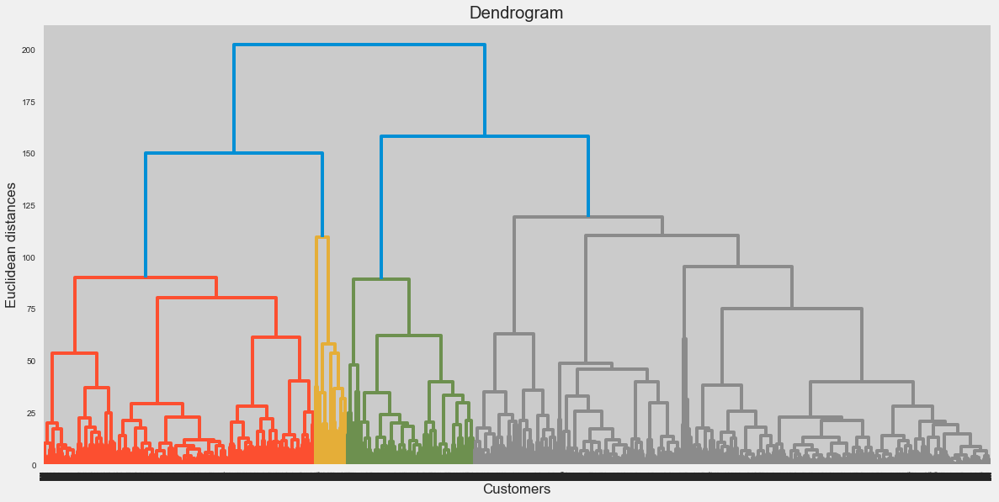

In [84]:
# dendogram
import scipy.cluster.hierarchy as sch
def dendogram(data):

    sch.dendrogram(sch.linkage(data, method='ward'))
    plt.title('Dendrogram')
    plt.xlabel('Customers')
    plt.ylabel('Euclidean distances')
    plt.show()

dendogram (scale_df)

In [85]:
sil=[]
chs=[]
for  k in range (2,11) :
    ha = AgglomerativeClustering (n_clusters=k , linkage='ward')
    ha . fit  (scale_df)
    sil_s = silhouette_score(scale_df , ha . labels_)
    sil . append (sil_s) 
    ha = AgglomerativeClustering (n_clusters=k , linkage='ward')
    ha . fit  (scale_df)
    chs_s = calinski_harabasz_score(scale_df , ha . labels_)
    chs . append (chs_s) 

Text(0.5, 1.0, 'calinski_harabasz_score')

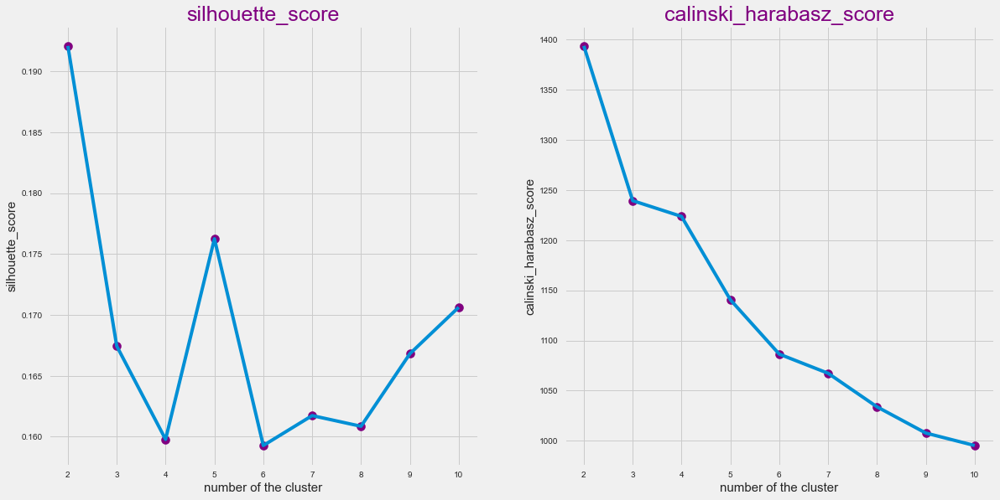

In [86]:
plt.style.use("fivethirtyeight")
plt . figure (figsize=(18,9))
plt . subplot (1 , 2 , 1)
plt . plot (range(2,11) , sil )
plt. scatter (range (2,11) , sil , marker ='o' ,s=100 , color='purple')
plt . xlabel('number of the cluster', fontsize = 15)
plt . ylabel('silhouette_score' , fontsize = 15)
plt . title ('silhouette_score' , fontsize=25 ,color='purple')
plt . subplot (1 , 2 , 2)
plt . plot (range(2,11) , chs )
plt. scatter (range (2,11) , chs , marker ='o' ,  s=100,  color='purple') 
plt . xlabel('number of the cluster' , fontsize = 15)
plt . ylabel('calinski_harabasz_score' , fontsize = 15)
plt . title ('calinski_harabasz_score' , fontsize=25 ,color='purple')

According to the diagrams above, n_clusters=2 is appropriate. Therefore, we implement the Agglomerative algorithm with n_clusters=2:

In [87]:
hi = AgglomerativeClustering (n_clusters=2 , linkage='ward')
hi . fit (scale_df)

AgglomerativeClustering()

In [88]:
# evaluation
silhi = silhouette_score (scale_df, hi.labels_)
print('Silhouette Score : ', silhi)
chhi = calinski_harabasz_score (scale_df, hi.labels_)
print('CH calinski_harabasz_score : ', chhi)
print('DB Score : ', davies_bouldin_score(scale_df, hi.labels_))

Silhouette Score :  0.19210277656035374
CH calinski_harabasz_score :  1393.5306043574565
DB Score :  2.0300293986465068


In [89]:
hi_df = df . copy()
label = hi . labels_
hi_df['clusters'] = label
hi_df

,BALANCE,BALANCE_FREQUENCY,PURCHASES,ONEOFF_PURCHASES,INSTALLMENTS_PURCHASES,CASH_ADVANCE,PURCHASES_FREQUENCY,ONEOFF_PURCHASES_FREQUENCY,PURCHASES_INSTALLMENTS_FREQUENCY,CASH_ADVANCE_FREQUENCY,CASH_ADVANCE_TRX,PURCHASES_TRX,CREDIT_LIMIT,PAYMENTS,MINIMUM_PAYMENTS,PRC_FULL_PAYMENT,TENURE,clusters
0,40.900749,0.818182,95.40,0.00,95.40,0.000000,0.166667,0.000000,0.083333,0.000000,0,2,1000.0,201.802084,139.509787,0.000000,12,0
1,3202.467416,0.909091,0.00,0.00,0.00,6442.945483,0.000000,0.000000,0.000000,0.250000,4,0,7000.0,4103.032597,1072.340217,0.222222,12,0
2,2495.148862,1.000000,773.17,773.17,0.00,0.000000,1.000000,1.000000,0.000000,0.000000,0,12,7500.0,622.066742,627.284787,0.000000,12,0
3,1666.670542,0.636364,1499.00,1499.00,0.00,205.788017,0.083333,0.083333,0.000000,0.083333,1,1,7500.0,0.000000,312.343947,0.000000,12,0
4,817.714335,1.000000,16.00,16.00,0.00,0.000000,0.083333,0.083333,0.000000,0.000000,0,1,1200.0,678.334763,244.791237,0.000000,12,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
8945,28.493517,1.000000,291.12,0.00,291.12,0.000000,1.000000,0.000000,0.833333,0.000000,0,6,1000.0,325.594462,48.886365,0.500000,6,0
8946,19.183215,1.000000,300.00,0.00,300.00,0.000000,1.000000,0.000000,0.833333,0.000000,0,6,1000.0,275.861322,312.343947,0.000000,6,0
8947,23.398673,0.833333,144.40,0.00,144.40,0.000000,0.833333,0.000000,0.666667,0.000000,0,5,1000.0,81.270775,82.418369,0.250000,6,0
8948,13.457564,0.833333,0.00,0.00,0.00,36.558778,0.000000,0.000000,0.000000,0.166667,2,0,500.0,52.549959,55.755628,0.250000,6,0


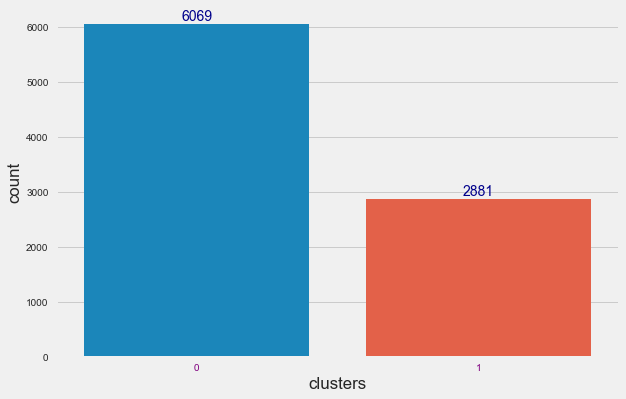

In [90]:
plt . figure (figsize=(9,6))
counttplot = sns . countplot (x='clusters' ,data = hi_df )
plt . bar_label (counttplot. containers[0] , color='darkblue')
plt . xticks(color='purple')
plt . show()

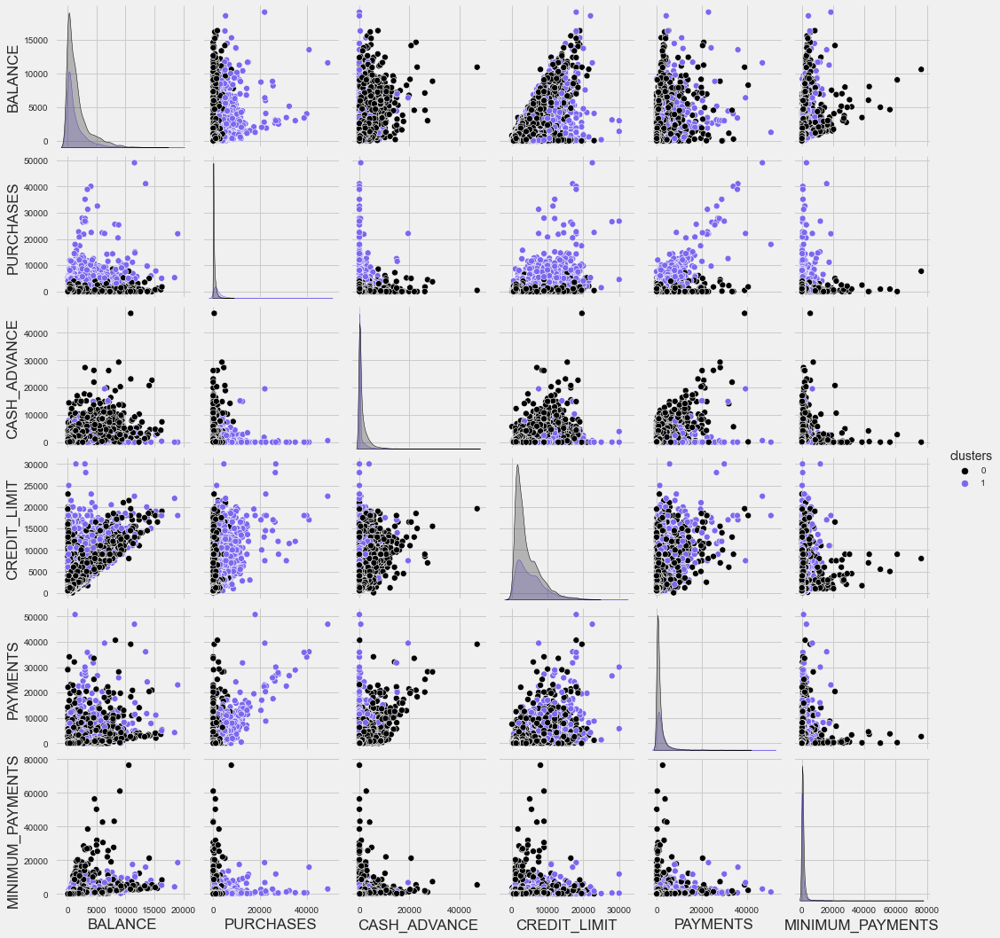

In [91]:
col = ["BALANCE", "PURCHASES", "CASH_ADVANCE","CREDIT_LIMIT", "PAYMENTS", "MINIMUM_PAYMENTS","clusters"]
palette= ['black', 'mediumslateblue']
pallet= ['blue', 'purple']
sns.pairplot( hi_df[ col ], hue="clusters" , palette = palette)

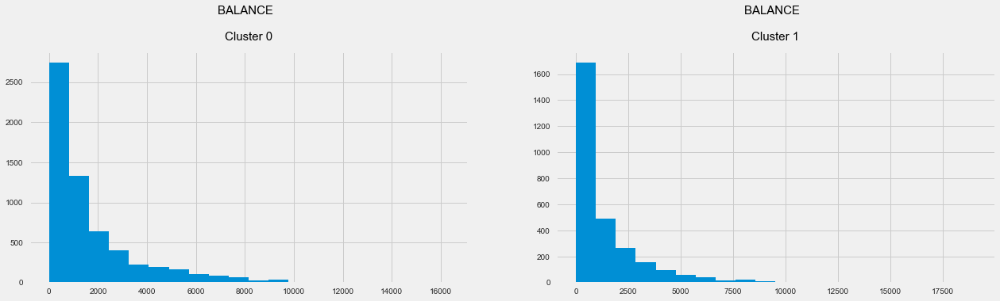

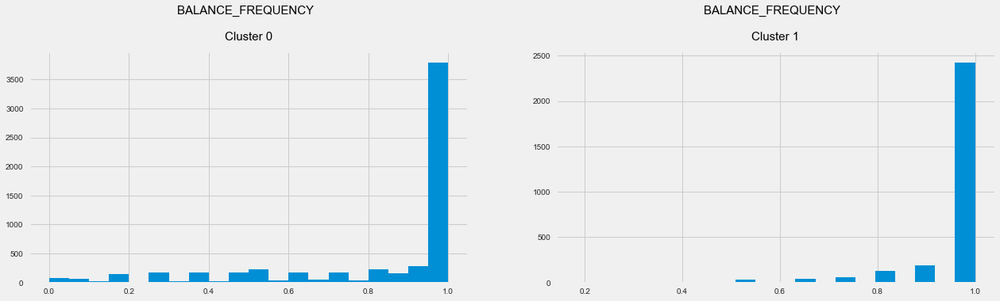

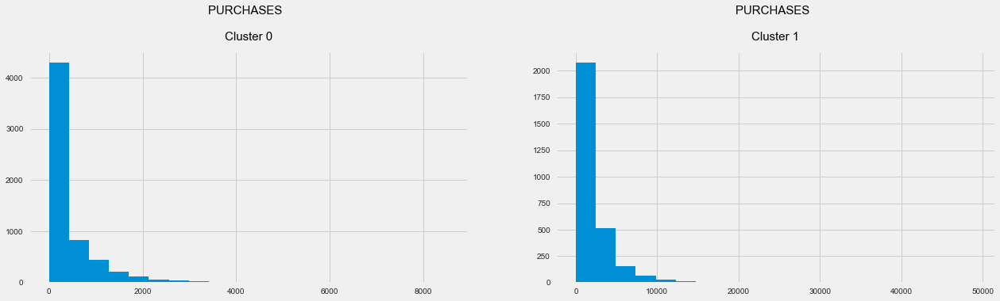

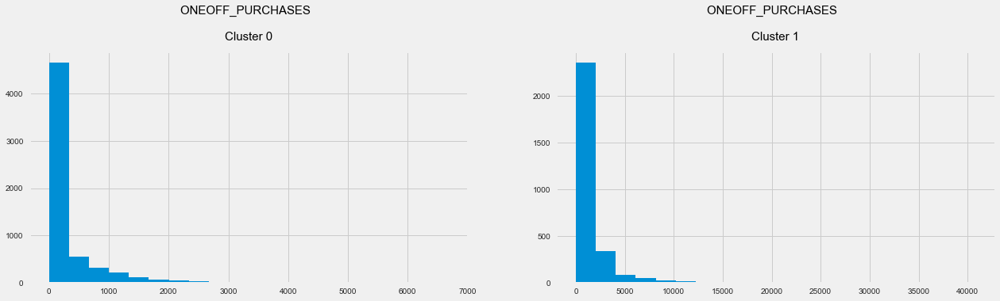

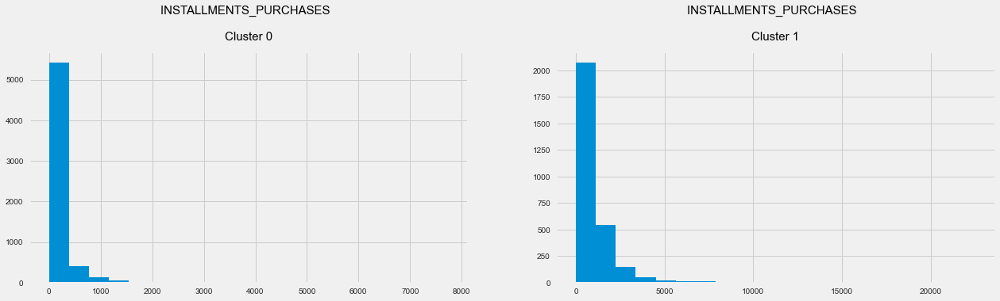

...

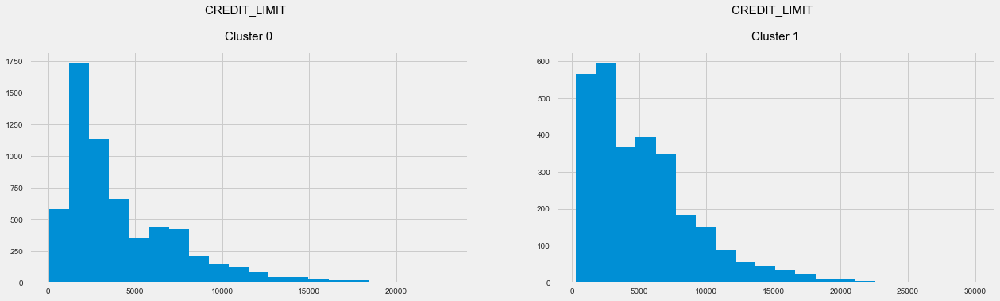

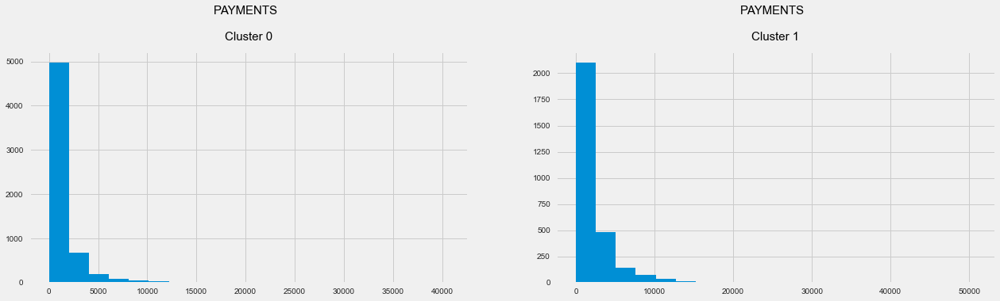

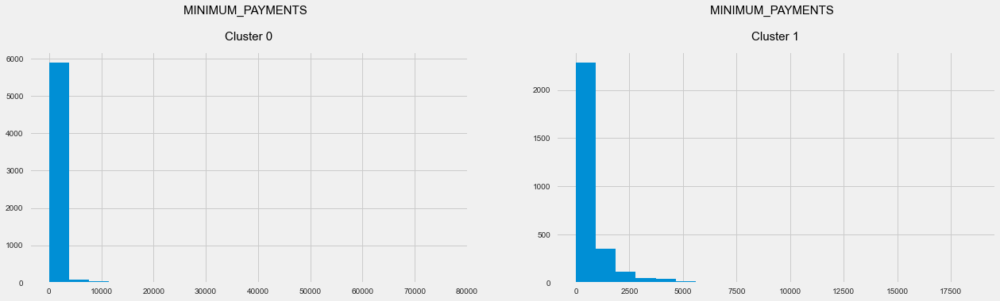

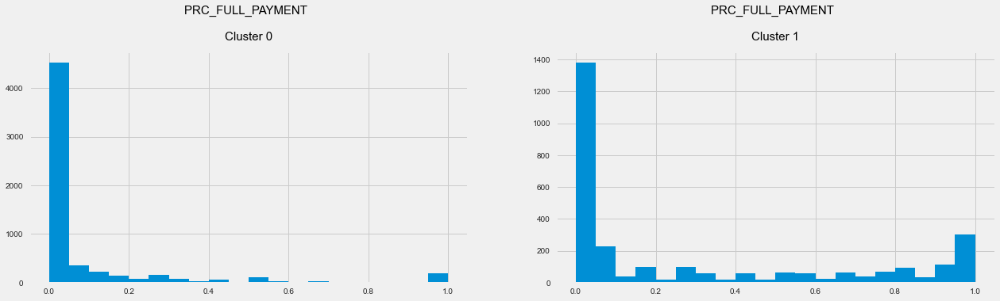

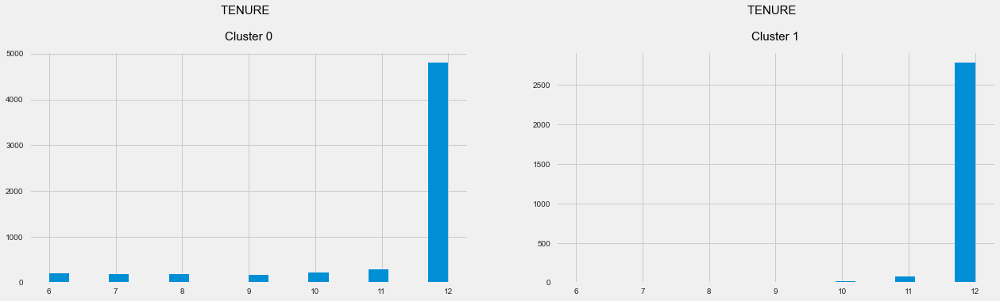

In [92]:
# Plot the histogram of various clusters
for i in df.columns:
    plt.figure(figsize=(30,5))
    for j in range(2):
        plt.subplot(1,3,j+1)
        cluster = hi_df[hi_df['clusters'] == j]
        cluster[i].hist(bins = 20)
        plt.title('{}  \n\nCluster {}'.format(i,j), color='black', fontsize = 15, y=1.03)
        
plt.show()

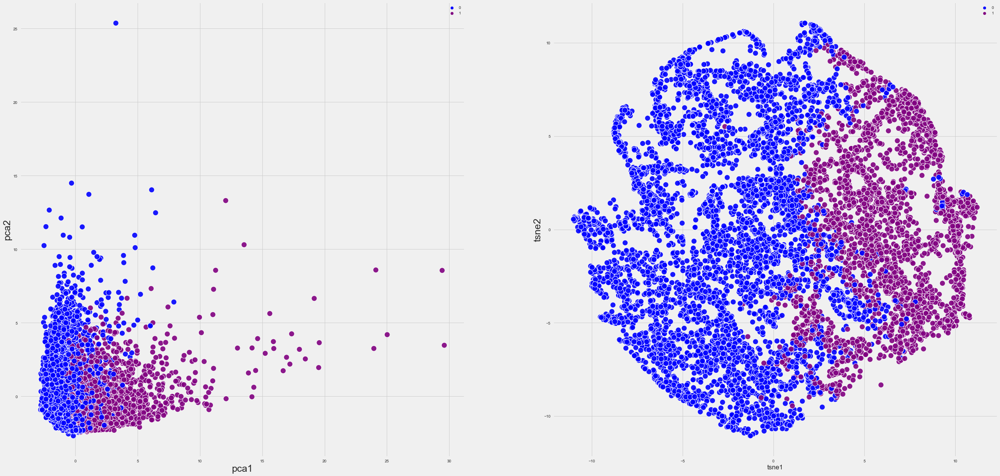

In [93]:
plt.figure(figsize = (40,20))
pallet= ['blue', 'purple']
plt. subplot (1,2,1)
sns . scatterplot (x='pca1' , y='pca2' ,hue= label , data= pca , palette= pallet,  alpha=0.9 , s=200)
plt . xlabel('pca1' , fontsize=25)
plt . ylabel('pca2' , fontsize=25)
plt. subplot (1,2,2)
sns . scatterplot (x='tsne1' , y='tsne2' ,hue= label , data= tsne ,  alpha=0.9 , s=200, palette= pallet)
plt . ylabel('tsne1' , fontsize=25)
plt . ylabel('tsne2' ,fontsize=25)
plt . show()

# <p style="background-color:#0C090A; font-family:newtimeroman;color:#736AFF;font-size:120%;text-align:center;border-radius:10px 10px;">Algorithm comparison</p>

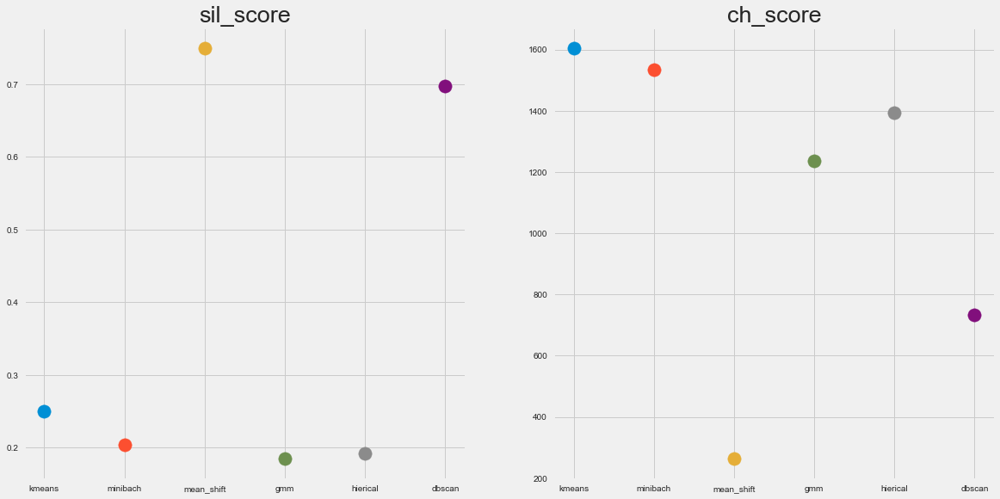

In [100]:
plt . subplot(1,2,1)
plt . title('sil_score' , fontsize=27)
plt . scatter ('kmeans' , silkm, s=234)
plt . scatter ('minibach' , silmb, s=234)
plt . scatter ('mean_shift' , silms, s=234)
plt . scatter ('gmm' , silgm, s=234)
plt . scatter ('hierical' , silhi , s=234)
plt . scatter ('dbscan' , sildb , s=234)
plt . subplot(1,2,2)
plt . title('ch_score' , fontsize=27)
plt. scatter ('kmeans' , chkm, s=234)
plt . scatter ('minibach' , chmb, s=234)
plt . scatter ('mean_shift' , chms, s=234)
plt . scatter ('gmm' , chgm, s=234)
plt . scatter ('hierical' , chhi , s=234)
plt . scatter ('dbscan' , chdb , s=234)

* according to the Silhouette criterion, Mean shift is the best model, and according to Calinski-Harabazs criterion, Kmeans is the best model. 

--------------------------------------------

# <p style="background-color:#FFFFFF; font-family:newtimeroman;color:#660000;font-size:93%;text-align:center;border-radius:10px 10px;"> If you liked it, upvoted, commented and shared❤️ </p>

# <p style="background-color:#FFFFFF; font-family:newtimeroman;color:	#008000;font-size:120%;text-align:center;border-radius:10px 10px;"> THE END</p>